<a href="https://colab.research.google.com/github/deynabaevax/groupm-graduation/blob/developing/code/modelling/embedding_BERTopic_jumbo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Modelling 
### Jumbo data

<hr>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Import the libraries

In [2]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

from sklearn.datasets import load_digits
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

import warnings
warnings.filterwarnings("ignore")

### Load the data

In [3]:
df = pd.read_csv("/content/drive/MyDrive/jumbo-lemmatized.csv")

In [4]:
df.drop(df.columns[df.columns.str.contains("Unnamed", case=False)], axis=1, inplace=True)

In [5]:
df.head()

,descr,source,clean_descr,stopw_descr,stopw,lemmatized
0,"Dag, ik had een probleem met mijn bestelling v...",WhatsApp,dag ik had een probleem met mijn bestelling va...,dag probleem bestelling gemeld ontvang vandaag...,dag probleem bestelling gemeld ontvang vandaag...,dag probleem bestelling melden ontvang vandaag...
1,Beste heer mevrouw Inmiddels zijn we 3 maanden...,WhatsApp,beste heer mevrouw inmiddels zijn we maanden ...,beste heer mevrouw inmiddels maanden verder st...,beste heer mevrouw inmiddels maanden verder st...,goed heer mevrouw inmiddels maand ver steeds r...
2,"Hallo, staan er voedingswaarden vermeld op de ...",WhatsApp,hallo staan er voedingswaarden vermeld op de f...,staan voedingswaarden vermeld flessen wijn ver...,staan voedingswaarden vermeld flessen wijn ver...,staan voedingswaarden vermelden fles wijn verk...
3,Bij Bestelling: 6057976661 had ik een servicec...,WhatsApp,bij bestelling [ORDER_NUMBER] had ik een servi...,bestelling [ORDER_NUMBER] servicecode ingevuld...,bestelling [ORDER_NUMBER] servicecode ingevuld...,bestelling [ORDER_NUMBER] servicecode invullen...
4,Hi! Ik heb mijn bestelling net ontvangen. Ik h...,WhatsApp,hi ik heb mijn bestelling net ontvangen ik had...,hi bestelling net ontvangen flessen ingeleverd...,hi bestelling net ontvangen flessen ingeleverd...,hi bestelling net ontvangen fles inleveren gro...


## Sentence Transformers

### Install the sentence transformers

In [ ]:
!pip install -U sentence-transformers

In [7]:
from sentence_transformers import SentenceTransformer, util

In [8]:
model = SentenceTransformer("distiluse-base-multilingual-cased-v1")

In [9]:
sentences = df["lemmatized"]

In [10]:
# encode the sentences
sentence_embeddings = model.encode(sentences)

In [11]:
sentence_embeddings.shape

(47856, 512)

In [11]:
# print the embeddings
for sentence, embedding in zip(sentences, sentence_embeddings):
    print("Sentence:", sentence)
    print("Embedding:", embedding)
    print("")

Streaming output truncated to the last 5000 lines.
 -1.50246117e-02  1.88526399e-02 -2.00045276e-02  2.76279915e-02
 -5.92411496e-03  2.00200416e-02  3.58440876e-02  2.58134995e-02
  6.86228052e-02  3.96120697e-02 -6.32848637e-03  1.30471983e-03
  6.31550420e-03 -3.24394219e-02 -4.89253700e-02 -4.96113189e-02
 -1.34272000e-03  4.20316793e-02  3.62458304e-02  2.63806246e-02
  5.26096672e-02 -8.13602656e-02 -2.69118994e-02 -2.61719208e-02
 -1.02795318e-01  2.09838129e-03 -2.08238903e-02 -2.11414732e-02
  6.79001287e-02  4.19648737e-03 -2.04768637e-03 -2.35345326e-02
  6.80279508e-02  5.42879291e-03  8.36386625e-03  6.55681826e-03
  8.99641588e-03 -6.69921516e-03 -4.07428816e-02 -6.80014789e-02
 -9.99875460e-03  6.98059052e-02 -2.55526099e-02  2.41565444e-02
  9.05508455e-03  1.14320568e-03  2.57134456e-02  9.30570625e-03
 -3.69797507e-03  1.27404481e-02  1.00321556e-02  2.22409982e-02
 -3.08225863e-02  3.25660664e-03  4.22407575e-02 -1.28763216e-02
  1.26844971e-02 -1.97849330e-02  2.952

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  1.34480791e-02 -4.03973833e-02 -1.33915320e-02  1.75290089e-02
 -3.12482268e-02 -3.40751894e-02  2.43991688e-02 -2.04501133e-02
  1.49782561e-02 -5.24195954e-02  3.02817486e-03 -1.48420297e-02
 -4.54967842e-03  8.17807950e-03  1.71188302e-02 -4.13895547e-02
  2.35829446e-02  6.90565333e-02  7.54287988e-02 -6.20598644e-02]

Sentence: zien groot prijsverschil hetzelfde brood binnen anderhalf maand plaatsvinden verschil groot wij ieder geval enorm geschrokken prijsstijging zon kort periode kopen jumbo soest arnaud graaf zien groot prijsverschil hetzelfde brood binnen anderhalf maand plaatsvinden verschil groot wij ieder geval enorm geschrokken prijsstijging zon kort periode kopen jumbo soest arnaud graaf chat qamar jumbo momenteel maken algemeen stijging kosten zoals hoog inkoopprijs bijvoorbeeld stijgen logistiek kost betekenen echter zomaar volledig stijging kost doorberekenen ons verkoopprijs kijken goed balans waarbij ons klant blij

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  4.49456535e-02  2.91346456e-03 -9.97203682e-03  3.62048112e-02
  1.96902491e-02  1.90461557e-02  5.81610426e-02 -8.74608681e-02
  5.72942058e-03  1.82375535e-02  2.99575236e-02 -2.16388199e-02
 -5.66223674e-02 -4.27377298e-02 -7.35990005e-03  5.71130728e-03
 -7.05238357e-02  6.66204840e-02  4.05309610e-02 -1.23223756e-03
 -2.90777385e-02  6.74180361e-03  2.72014812e-02 -4.10241336e-02
  2.17875633e-02  9.22512170e-03 -1.90272294e-02  3.16765858e-04
 -2.54284497e-02  3.65702510e-02  1.64614879e-02 -3.06325555e-02
 -1.20306527e-02 -2.37546358e-02  2.45764032e-02 -2.71105263e-02
  5.61106892e-04 -3.90305743e-02  3.25612351e-02  1.39521156e-02
 -5.25765121e-03 -4.62675616e-02  1.65288802e-02  3.26701067e-02
 -2.14395747e-02 -4.50841896e-02  2.07701083e-02 -6.62462488e-02
  2.87698768e-02 -2.15578433e-02 -5.50351925e-02 -6.45388616e-04
 -5.99224642e-02  8.09301212e-02 -2.03020833e-02  1.23427166e-02
  3.73536684e-02 -6.70077950e-02  1.040

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -6.31124899e-02 -8.94870376e-04  1.99935380e-02 -8.73545259e-02
  3.22723994e-03 -4.18823352e-03 -1.84865687e-02  7.06733391e-02
 -1.27900662e-02 -3.13799158e-02 -1.56311821e-02  1.42813912e-02
 -9.04984474e-02  3.10934149e-02 -2.75394274e-03  1.52347693e-02]

Sentence: timeout message account samenvoeg
Embedding: [-6.51544109e-02  2.27475762e-02  1.78945288e-02  3.57224271e-02
  7.92406276e-02 -6.26301989e-02 -2.88178399e-02  5.80564048e-03
  1.44677088e-02  2.55809706e-02 -1.40901953e-01 -3.99958305e-02
  3.43271391e-03  2.15120576e-02 -9.48066916e-03  4.43500001e-03
  3.26627791e-02  4.04299125e-02 -5.25189415e-02 -5.22110239e-02
  5.26804850e-02  5.03739007e-02  7.38579780e-02  2.03431537e-03
 -8.04472044e-02 -3.23233521e-03  5.53982556e-02 -2.11344380e-02
  5.75665720e-02 -6.73200050e-03 -5.69920056e-02 -2.86449660e-02
 -6.69538882e-03  2.40485854e-02 -3.41979675e-02  1.05775937e-01
  2.42156722e-02  3.71691659e-02 -2.02140585e-0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  4.68071103e-02  2.16492712e-02 -6.48332834e-02 -8.46816972e-03
  4.33173776e-03  2.09347866e-02 -2.80704219e-02 -4.28400263e-02
  6.75604790e-02  5.34671545e-03  6.22239022e-04 -5.87875955e-02
 -2.01571174e-02 -2.18665078e-02 -5.09102605e-02  2.54806019e-02
  1.64897852e-02  3.32938954e-02 -2.68723890e-02  4.25339444e-03
  1.89672876e-02 -2.13128794e-02  3.10168369e-03 -3.87283191e-02
 -5.85874468e-02 -3.45033333e-02  2.37793326e-02 -4.90575656e-02
 -1.53358802e-02  3.73287275e-02 -5.24038449e-02 -1.27235102e-02
  4.48241755e-02  6.72259629e-02  5.14395311e-02 -4.01440971e-02
 -7.30260136e-03 -1.13514848e-02  2.96608638e-02 -1.35394651e-02
 -2.87544895e-02 -3.24575230e-02  6.91977069e-02 -5.54349422e-02
 -1.09129446e-02  5.76604865e-02  1.92776211e-02  3.45556736e-02
 -2.23551169e-02  6.91043884e-02  1.75001118e-02 -2.77994741e-02
  2.70584356e-02 -1.00222742e-02  4.21913303e-02 -1.17175526e-03
  3.36553380e-02 -1.26824891e-02 -6.366

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -2.44660191e-02  2.06264276e-02 -3.20550352e-02  4.40465398e-02
 -6.59105787e-03  9.68491565e-03 -2.88718846e-03 -6.12865156e-03
 -3.74592058e-02 -6.08094037e-02  1.54228294e-02  2.11265124e-02
  6.64666668e-02 -2.11359151e-02 -9.15408600e-03 -2.21261512e-02
 -8.60194489e-02  1.91932730e-02  4.23359722e-02  1.21240942e-02
  1.23736467e-02 -6.68214783e-02  7.49527290e-03 -5.07709663e-03
 -4.11475115e-02 -1.45750225e-03 -1.48516698e-02 -8.08794610e-03
 -3.70390117e-02  1.69644132e-02  3.87647003e-02 -1.73865110e-02
 -3.04068401e-02 -3.14595439e-02  4.63929027e-02 -5.06098149e-03
 -1.62454415e-02 -2.88154911e-02 -7.78606534e-02 -3.63540947e-02
 -3.64702977e-02 -3.94432731e-02 -1.53917633e-02 -5.92977833e-03
  4.71134745e-02 -2.64784805e-02  6.22483389e-03 -1.62629411e-03
 -4.31200955e-03  3.49539481e-02 -2.92144697e-02  3.14556099e-02
  7.43598267e-02 -5.43556288e-02  2.23056879e-02 -2.37926133e-02
  5.80700114e-02  2.25995481e-02 -1.965

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
Sentence: goedenavond gaan online bestelling vragen aanbieding espresso koffie gratis winkel voorraad wel graag gebruik maken mooi aanbieding chat gabrin helaas zullen jumbo buurt moeten gaan product online bestellen hoop voldoende nformeren fijn dag ver dank reactie al jumbos buurt leveren sowieso voorraad sommig actie lopen storm product tijdig leverbaar excuus hiervoor
Embedding: [ 2.39639282e-02 -6.24004789e-02  4.75591281e-03 -2.47684866e-02
  8.09361041e-02 -4.39071804e-02 -2.33938694e-02  2.14037206e-02
  1.95899978e-02  5.00984192e-02  1.63436625e-02  4.04373035e-02
 -2.96427906e-02 -1.45652506e-03  3.33966501e-02  6.90830499e-02
  8.97838771e-02  6.87324181e-02 -1.59260370e-02 -3.68122868e-02
  2.33506877e-02  4.25795503e-02 -4.72080261e-02  5.70878834e-02
  1.76763423e-02 -4.54999655e-02 -2.24579088e-02 -1.32323410e-02
 -2.39375029e-02  3.77034657e-02  1.95276961e-02 -3.36262994e-02
 -2.57454067e-02 -5.54553680e-02  2.9666642

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
Sentence: net gebak kopen korting krijgen vandaag procent korting chat kimberley waar staan korting krijgen gebak koeling gebak goed terug filiaal ver mee helpen ok bedanken
Embedding: [-8.53106566e-03 -1.10130059e-02  2.88255811e-02  3.96032259e-03
  1.02899596e-01 -1.14383530e-02 -4.90389094e-02  1.56609621e-02
 -2.02917345e-02  1.49570554e-02  4.65930812e-02  2.42358092e-02
  5.88861480e-03 -8.22036713e-02 -1.44955656e-02 -6.66858908e-03
  6.26114681e-02  4.26778384e-02  6.09163847e-03 -2.88912300e-02
 -2.86844186e-03 -3.64334099e-02 -2.99498476e-02  1.60428844e-02
 -2.12361272e-02  1.00528132e-02  1.33209266e-02 -5.34738190e-02
 -7.45061785e-02 -1.13925599e-02  4.20211665e-02 -1.77313238e-02
 -1.95174653e-03 -6.96984082e-02  2.46136636e-02 -9.48441215e-03
 -3.29501070e-02  3.48344818e-02 -6.43871576e-02  9.08490643e-02
 -7.73251355e-02  9.52743068e-02 -1.36167556e-02 -3.74274403e-02
 -1.14792801e-01  3.82526801e-03  7.68370330e-02 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  1.78210232e-02  1.62024256e-02  3.07856966e-02 -2.72665620e-02
 -9.31927841e-03  2.04574503e-03 -3.33718322e-02  5.92703521e-02
 -6.63811937e-02 -4.79355268e-03 -3.70710641e-02 -5.36453277e-02
  2.54420098e-02 -1.61228105e-02  4.55713645e-02 -4.74809669e-02
  3.92688811e-02 -5.09465262e-02  8.17204714e-02 -7.72418082e-03
  7.43006393e-02  3.52130383e-02 -2.74274722e-02 -9.39912200e-02
  2.98357802e-03 -2.41839383e-02 -2.35352479e-02  2.44423077e-02
  1.91502981e-02 -1.19691920e-02 -5.98010309e-02  6.40201792e-02
  1.71090607e-02 -3.29102390e-02  1.69759467e-02  6.12125136e-02
 -2.27014236e-02  1.47074489e-02  7.88632594e-03 -6.55915774e-03
  1.48654450e-02  1.78985521e-02 -8.47557560e-02 -2.02921927e-02
 -3.16194929e-02 -1.65753101e-03  6.16750084e-02  1.23115601e-02
 -2.53618825e-02  6.19347021e-03 -4.76243673e-03 -3.32383625e-02
  1.05446987e-02 -2.41570529e-02  4.49023657e-02 -4.53249589e-02
  2.18610279e-02 -2.51425542e-02  9.602

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -0.02956863 -0.09684239 -0.02565425  0.03508732 -0.03065881 -0.00731198
  0.01190461  0.04791174 -0.01891497  0.00397941  0.05923622  0.00702707
  0.0292045  -0.10469998  0.0511494   0.0152952  -0.05966508 -0.03248682
  0.02248374  0.03583091  0.05938874  0.00495042 -0.0475916   0.01357236
  0.05761851 -0.0592187   0.00834174  0.03451374  0.00024555  0.03551722
 -0.03143743 -0.01780079 -0.09279469  0.04968186 -0.06341636  0.03621368
 -0.05899252  0.05169234 -0.01286479  0.03806379  0.01317221  0.008464
  0.01601303 -0.07919447  0.00286836  0.0023434  -0.03819307 -0.0038556
 -0.03547925  0.00446091 -0.00079114  0.00987666 -0.02526507 -0.03288774
  0.09279202 -0.03224349 -0.0341318  -0.01268029 -0.00110492  0.02021415
 -0.0190517  -0.02249514  0.01593792  0.00957347  0.03576836  0.033392
  0.03349524  0.03459607  0.0060272  -0.01016584 -0.01293464 -0.03156896
  0.02459624  0.00989592  0.04806892 -0.02742533  0.00603555  0.01188021
 -0.0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  2.14402005e-02 -2.10145619e-02 -6.78356066e-02  3.70233022e-02
 -4.32834215e-02 -2.61104703e-02 -4.33243252e-02  1.62669756e-02
 -8.37447587e-03 -6.45540953e-02 -8.71816576e-02 -4.61964533e-02
  2.61512101e-02  3.42105180e-02 -2.45972574e-02  1.98739525e-02
 -1.83207411e-02  1.29107703e-02  2.96413321e-02 -8.85225926e-03
  5.04312739e-02 -9.71753523e-03 -3.51828113e-02  7.55832344e-02
  2.75227670e-02 -9.41512454e-03  4.97362316e-02 -5.58172129e-02
  4.99118753e-02 -3.05976290e-02  5.79499342e-02  2.23698001e-02
 -2.36581732e-02 -1.41222039e-02  6.69168867e-03  3.50920595e-02
 -7.03026876e-02  4.03569043e-02 -3.15090385e-03  2.36109807e-03
 -1.81659795e-02  7.83035532e-03  4.58652303e-02 -1.72730088e-02
  3.31051238e-02 -2.34106407e-02 -5.07579036e-02 -5.69692999e-03
 -5.34574427e-02  7.29317963e-02  2.56622899e-02  2.46699117e-02
  3.47446501e-02  6.13352656e-03  6.82101250e-02  1.30380942e-02
 -4.48116101e-02 -1.09763093e-01 -2.602

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -6.72930479e-02  2.27859430e-02  6.59303069e-02 -1.84930619e-02
 -7.11887628e-02  4.12120596e-02 -8.03443231e-03  6.32395074e-02
 -3.55658196e-02 -2.42141318e-02 -6.21978119e-02 -6.50800318e-02
 -2.36679893e-02 -4.30079475e-02  1.04168937e-01 -3.47205028e-02
 -2.23852340e-02 -3.83691080e-02  2.66315369e-03  3.66310328e-02
 -3.37334387e-02 -4.52145375e-03 -2.47931555e-02 -8.45593587e-02
  6.09630197e-02 -4.82242778e-02 -2.73771770e-03  1.86758824e-02
  2.14137752e-02 -2.16470510e-02  9.11472514e-02 -9.02186148e-05
  5.38554341e-02  4.36445177e-02 -2.66887713e-02 -8.16776305e-02
  4.00956981e-02 -1.77653991e-02 -5.64321242e-02  2.70819701e-02
  7.31162867e-03 -8.57925341e-02 -4.11162972e-02  8.27488974e-02
  5.33889793e-02 -3.67637724e-02  1.07683521e-02  8.78442228e-02
 -3.50686647e-02  9.16199200e-03 -2.25305520e-02  2.96001919e-02
  4.07872610e-02  1.26245990e-02  1.80155057e-02  3.02809943e-02
  1.96028035e-02  2.54224315e-02  7.583

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -7.38463700e-02 -4.52279039e-02  8.78076442e-03  2.31288448e-02
 -3.74598987e-02  5.76346787e-03 -6.70573115e-03  3.96128818e-02
  3.19935195e-02 -4.42353413e-02  3.90968919e-02 -4.25539054e-02
 -5.33115342e-02  1.16735883e-02 -1.65823810e-02 -3.28007713e-02
 -2.66878735e-02 -8.01834837e-03 -1.12611856e-02  6.89372281e-03
 -4.57569212e-03  1.19030159e-02 -1.83634274e-03 -1.17454380e-02
 -1.78742071e-03  1.32707180e-02  5.72272670e-03 -1.16459634e-02
  6.24562725e-02  3.02919038e-02  8.74973647e-03 -1.62423868e-02
  5.32201957e-03 -5.37920035e-02 -1.30118439e-02  5.82304262e-02
  2.93233935e-02 -6.73941001e-02  1.32945227e-02  2.04982702e-04
  1.86013728e-02  2.20216364e-02 -2.16351938e-04 -6.02753982e-02
  1.64295323e-02 -8.65450129e-03 -9.08394577e-05  2.60343496e-02
  2.70316959e-03 -4.12266441e-02  3.95341665e-02 -6.52510822e-02
  5.02570979e-02  1.12435333e-02  5.96347637e-03 -3.79013531e-02
  1.37566738e-02  5.50185284e-03  4.276

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  7.68035278e-03 -2.53817216e-02  5.36072738e-02  1.17368065e-04
 -6.70842268e-03 -6.45940453e-02  7.37357438e-02  4.49763872e-02
  4.77926433e-02  2.66163573e-02  2.00387388e-02  1.07341558e-02
 -6.20226227e-02  1.79673713e-02  6.84415363e-03  1.74054690e-02
 -1.03636971e-02  1.32940905e-02  6.12566918e-02  2.72785258e-02
  2.71988064e-02  5.59707806e-02 -3.60126942e-02 -1.25073614e-02
 -1.92401465e-02 -4.99709928e-03  8.89887474e-03 -1.44513231e-02
  9.16461367e-03 -3.88687998e-02  5.88338114e-02  8.39941204e-02
  4.12835367e-02  3.10749058e-02 -5.77384885e-03 -2.52321530e-02
 -1.95263587e-02  2.05023214e-02  2.51390878e-02 -6.17040358e-02
  1.06220134e-02 -9.29912366e-03  7.96073899e-02 -3.12538333e-02
  4.55104113e-02 -4.85038646e-02 -5.34095317e-02 -8.82578120e-02
  2.31668297e-02  5.50525216e-03 -7.10266456e-02  2.72026397e-02
 -2.43902188e-02  1.14197396e-02  1.80477966e-02  5.20213805e-02
  2.15887446e-02 -4.23671603e-02 -1.001

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  2.96961926e-02 -8.67191423e-03 -3.43685672e-02  4.19967994e-03
 -4.78133149e-02 -7.12868273e-02  5.94224036e-02 -1.64093934e-02
 -3.35429348e-02 -3.55342254e-02  5.07850982e-02 -7.82805402e-03
 -3.08078043e-02 -7.99489990e-02  1.26672581e-01  2.70206686e-02
  7.07581192e-02  7.22615886e-03  7.33601721e-03 -5.55914752e-02
  4.38487902e-03  2.42877435e-02  7.17202341e-03  1.39766624e-02
  3.38287055e-02 -2.48929411e-02 -2.78006811e-02 -4.86568734e-02
 -2.37747654e-02  2.77486220e-02  1.14549522e-03  4.18257117e-02
 -5.82057377e-03  6.50463179e-02  7.66592249e-02  8.20402950e-02
  3.85073088e-02 -3.52648534e-02 -4.30742186e-03 -9.16714594e-03
  2.65331157e-02 -1.08529581e-03 -4.97058593e-02 -9.49090440e-03
  1.78519525e-02 -7.77923390e-02 -2.69504674e-02 -6.91372082e-02
  2.29791179e-02  4.02734242e-02 -1.85924396e-02 -1.51219461e-02
  2.95385048e-02  7.05704018e-02  5.97671568e-02 -1.29780918e-02
  1.11382576e-02 -5.99965863e-02 -7.913

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  2.51483954e-02 -1.35786356e-02 -5.99442646e-02  4.57422063e-02
  1.60670895e-02 -3.25234495e-02 -9.39417351e-03 -5.86412884e-02
 -5.28574409e-03  5.50899329e-03  6.50410131e-02 -3.62862721e-02
 -4.55687307e-02  4.14697267e-02  9.63952020e-03  3.92193124e-02
  5.62001625e-03 -3.99321839e-02  3.43219452e-02  1.62427612e-02
  1.05873831e-02 -4.82537188e-02 -2.59878132e-02  2.39190385e-02
 -2.68109031e-02 -3.55060622e-02  1.99192483e-02  6.36521950e-02
 -8.22876487e-03  5.96051253e-02 -6.54570162e-02 -4.47660238e-02
  1.86205953e-02  3.55745554e-02  4.08448726e-02 -1.42290015e-02
 -3.72291207e-02  6.30322844e-02  2.49614269e-02 -2.03839839e-02
 -5.82714267e-02  1.01884371e-02  1.80881843e-02 -5.96895367e-02
 -4.12786938e-02 -3.13704163e-02  5.84883578e-02  1.76212192e-02
 -1.49583742e-02 -2.60983631e-02  4.09095809e-02  2.04072054e-03
 -4.30459082e-02 -2.02815812e-02  1.70015804e-02 -3.16893868e-02
  2.49428581e-02 -1.86707675e-02  2.013

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -4.43057455e-02 -6.74383491e-02  5.60390239e-04  5.00092655e-02
  4.27485583e-03  1.29481982e-02 -2.08059177e-02 -8.93100514e-04
 -7.21349716e-02  3.30888852e-02  2.75104996e-02  1.41635025e-02
  3.13575268e-02  1.12862803e-01 -3.25711481e-02 -3.23912920e-03
  6.30389946e-03  2.00283248e-05 -3.74899656e-02  2.56073941e-03
 -2.56200749e-02  1.06655611e-02  7.36113116e-02  8.13493505e-03
  6.95016468e-03 -2.14683991e-02 -2.39120126e-02  1.16329128e-02
 -3.53680775e-02 -1.31250895e-03 -6.71131313e-02  2.83162892e-02
  7.62447109e-03 -7.67312804e-03  2.16976833e-02 -7.73302792e-03
  4.14331146e-02 -5.56947738e-02  8.00796375e-02  8.11451767e-03
  1.08392742e-02  4.35595773e-02 -2.69183759e-02 -5.72354570e-02
  8.07997808e-02 -1.88072454e-02  1.08351959e-02  1.72687452e-02
  4.63596955e-02 -3.04395054e-02 -7.10058883e-02  3.63212787e-02
  2.53015552e-02 -1.94367301e-02 -1.56597234e-02  6.21264093e-02
 -3.13815363e-02  4.33019549e-02  1.915

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  0.01780681  0.02442883 -0.00240436  0.00427249 -0.07268254 -0.01320076
  0.01093506  0.00433817 -0.01697074 -0.08411469 -0.0457674   0.03427255
  0.07732382  0.00631931  0.01291703 -0.02971484 -0.05238032 -0.02981305
  0.04246104 -0.05489374  0.01874545 -0.04898582 -0.01061096  0.04215099
 -0.0068568   0.00115443  0.03300328 -0.01239055  0.00512858  0.04184058
  0.04990872 -0.01366594]

Sentence: graag berichtje managemenen stuuren ons boodschapp vaak jumbo weimaarstraten den haag helaas filiaal lijken gebrek goed begeleiding veeeel product juist vak plaatsen diet leiden verwarring kassa zien nemen mee kasa beseft prijs anders product vak staan terug controler zoeken juist product kosten tijd irritant wij maken bijna dagelijks mee soort marketing truc gaan wij nooit jumbo boodschapp vaak probleem afwijken prijs eerst betalen daarna customer service balie gaan moeten oproep gaan controleren komen terug zeggen vinden vragen mee lopen l

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -9.92824323e-03 -4.10582572e-02 -2.17385571e-02 -2.79981084e-02
 -3.02025918e-02 -7.11251516e-03  5.27377203e-02 -2.89947260e-03
 -8.32203329e-02  2.03998461e-02 -1.90881379e-02 -4.34264690e-02
 -5.54985963e-02 -6.03631288e-02  6.13003317e-03  9.32210684e-02
 -5.19719087e-02 -2.95179468e-02 -3.55830928e-03  1.60966292e-02
  4.90618423e-02 -2.97272205e-02 -2.39550415e-03 -1.56048751e-02
  7.76673183e-02 -4.83425520e-02  3.14922966e-02 -9.92753915e-03
 -1.66990776e-02 -8.00918788e-02 -3.29500474e-02  1.97122004e-02
  3.99406329e-02  4.64499854e-02 -2.94089261e-02  4.51692268e-02
 -7.90804531e-03 -2.31532417e-02 -2.55943332e-02 -2.87656114e-02
 -2.04055365e-02  4.71482612e-02  1.69444624e-02 -3.50396708e-02
  4.97753322e-02  2.98228953e-02  8.21722206e-03 -7.77889555e-03
  9.81394481e-03  4.23331372e-02  1.43795914e-03 -2.49453522e-02
 -9.35725495e-03  4.24229242e-02 -6.14221394e-03 -5.57031333e-02
 -6.44163555e-03  7.55895600e-02 -1.582

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  2.46997736e-02 -4.43935134e-02  3.80008225e-03 -3.32228914e-02
  5.68636917e-02  6.53681159e-02 -4.50143293e-02  6.19459711e-03
 -2.22558621e-03 -2.03725342e-02  2.03235578e-02  4.34950702e-02
  4.44630347e-02  9.48046297e-02  2.44611893e-02 -1.81741118e-02
 -1.41961146e-02 -2.23622285e-02  5.37919775e-02  2.71467445e-03
 -9.58614144e-03  4.26914282e-02  2.29559094e-02  1.50065217e-02
 -2.35435124e-02 -2.11373325e-02 -1.25814741e-02 -1.74939446e-02
 -3.98257859e-02  2.32433714e-02  1.71223640e-01 -6.45193160e-02
 -4.63371910e-02 -1.18892426e-02  6.00747243e-02  2.55245641e-02
 -8.20947625e-03 -3.18190921e-03 -7.50925839e-02 -3.42027433e-02
  1.13711338e-02 -6.06644042e-02 -7.02911764e-02 -2.22229976e-02
  4.72935438e-02 -1.93375535e-02  6.59079850e-02  9.33802593e-03
  6.45253658e-02 -2.84796897e-02 -5.14844097e-02 -8.43679067e-03
  4.53238301e-02 -4.58363928e-02 -2.80125588e-02  5.10958023e-02
  7.66977109e-03 -4.31949459e-02 -5.002

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -2.35699452e-02  5.55504626e-03 -2.61501293e-03  4.33258759e-03
  2.60584727e-02 -4.02949490e-02 -2.37250086e-02  1.21777188e-02
  4.66953367e-02  3.10246535e-02  3.21804779e-04  1.37685183e-02
  6.74422737e-03  1.90460514e-02 -3.76878753e-02 -1.63347758e-02
 -5.36442287e-02  3.28400359e-02  4.68664877e-02 -3.13050710e-02
  7.49617117e-03  4.39438000e-02  4.54150094e-03 -4.58411984e-02
  1.54515998e-02 -3.84825747e-03  2.00733524e-02 -5.40803047e-03
  8.83463677e-03  1.75174363e-02 -6.38848357e-03 -2.17419975e-02
 -2.54836194e-02 -3.90456468e-02  4.87426408e-02  1.54795051e-02
  1.75824426e-02 -1.39564741e-03 -6.75607705e-03 -5.40706962e-02
  1.64733455e-02  1.80056896e-02 -1.84764378e-02  6.61073159e-03
  1.92757975e-02  1.82322357e-02  5.05812792e-03  1.28693106e-02
 -1.45199224e-02  4.79001254e-02  1.27913328e-02 -3.15607269e-03
 -7.73008738e-04 -3.36729153e-03 -6.49913773e-02  1.53716523e-02
  1.31668663e-02 -5.92303760e-02  7.234

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  2.46149153e-02  1.62226148e-02 -1.31926881e-02  4.15126085e-02
  4.01691049e-02  7.66387507e-02 -5.34908101e-02  1.81281436e-02
  3.53680528e-03  1.11657232e-02 -4.79782447e-02  4.94583435e-02
 -3.13634574e-02  2.67026220e-02 -1.36875510e-02  4.72972839e-04
 -1.85545590e-02 -1.53045729e-02  4.03004475e-02  3.53297964e-02
 -8.48181695e-02 -4.13079001e-02  7.74652734e-02 -1.60294548e-02
 -3.49005908e-02  4.82500419e-02 -1.38964979e-02  7.76475072e-02
  7.85522722e-03  3.08845062e-02  1.04333824e-02  2.08570585e-02
  4.67042178e-02  3.80807333e-02 -1.41693931e-02  4.02369164e-02
 -6.08156472e-02 -6.89418847e-03  2.50552073e-02  1.46790799e-02
 -3.87587883e-02  5.70357516e-02  3.66781428e-02  1.17530795e-02
 -3.81047130e-02 -7.36281788e-03 -7.88613874e-03  5.43397095e-04
  3.87306400e-02 -3.68540324e-02 -3.34106535e-02 -4.77187708e-02
 -1.80783235e-02 -1.31485276e-02 -5.52422926e-02  8.14038794e-03
  2.57680807e-02 -3.60310785e-02  3.169

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  6.34184182e-02 -1.72855891e-02  3.20809335e-02  3.52652855e-02
  1.25314174e-02  6.33152621e-03  1.19113093e-02  3.43210576e-03
  6.45504380e-03 -4.14461717e-02  2.53564101e-02 -2.69532427e-02
  1.72306672e-02 -4.36103009e-02  1.02402054e-01  1.57604963e-02
  2.87916381e-02  2.98722051e-02 -5.56993205e-03 -4.61890772e-02
  2.02246942e-02 -2.69382987e-02 -5.31006530e-02  3.47829214e-03
 -3.40898447e-02  1.62683579e-03 -4.78586778e-02  2.74272934e-02
  4.54849675e-02 -5.08939698e-02  3.87261063e-02  8.98783058e-02
 -3.82056162e-02 -1.79960933e-02 -4.68434542e-02 -6.27687247e-03
  5.42997457e-02 -5.08682476e-03 -1.84869375e-02 -5.54632209e-02
  5.25332429e-02 -2.69854572e-02  2.00261958e-02 -8.58942419e-03
  8.85180011e-03 -5.17721400e-02 -2.32658116e-03  3.72308195e-02
  4.04906683e-02 -1.59841944e-02 -1.44092310e-02 -5.41021898e-02
  3.80619243e-02 -8.46706424e-03  3.65177915e-02  1.87654551e-02
  3.93741205e-02  1.17331585e-02  4.169

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -7.45923817e-02 -5.12474924e-02  2.16261717e-03  2.70833112e-02
  4.08473946e-02 -1.92986354e-02 -1.49121741e-02 -7.75486836e-03
  6.80076331e-02 -3.84847336e-02 -1.89000666e-02  2.20082365e-02
  1.22454697e-02 -3.25688459e-02  1.27777150e-02 -2.94155572e-02
 -3.71804014e-02 -8.43476132e-02 -2.64418498e-02 -3.40770520e-02
  3.28875929e-02  1.44187566e-02 -7.37287849e-02  5.90240173e-02
  2.44183205e-02 -1.06897401e-02 -7.37692490e-02 -5.35294302e-02
 -4.26613353e-02 -2.32929196e-02  5.33270910e-02  2.07871269e-03
 -1.90451164e-02 -7.33202370e-03  1.12716733e-02 -3.86167169e-02
  4.48314399e-02  4.28003334e-02  9.51641519e-03  4.70967591e-02
 -2.12131180e-02  3.28269638e-02  2.13350318e-02 -3.50466929e-02
 -3.98121066e-02  1.18182357e-02  2.28545517e-02 -5.52448779e-02
  3.57860811e-02 -3.37707251e-02 -7.79552339e-03  3.51073332e-02
 -1.26368314e-01  1.12582959e-01  3.72841880e-02 -2.84051709e-02
 -3.82397324e-02 -4.09681089e-02  1.732

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -0.05752467 -0.09544718 -0.07792647 -0.01842914  0.02998957  0.01340116
 -0.10105279 -0.01242556 -0.02919484 -0.06867602  0.03065537  0.01438486
  0.01545769 -0.03478841]

Sentence: hoi vraagen extra pas app geactiveeren pas n fysiek pas ander nummer allebei app koppelen pas verwijderen behoud punt mischa chat dewi bedanken bericht goed contact opneemmen welk pas scan punt fysiek pas pas app namelijk mogelijk twee hoofdpass koppelen tenzij fysiek pas koppelpas koppelen pas app via extra pas toevoegen jumbos extras app hoor graag lukken hoi scan punt fysiek pas ander nummer pas app manier punt overhevelen staan digitaal pas punt raad verwijderen account maken fysiek pas beide pass staan punt begrijpen pas hebben kaart app kunnen servicebalie koppelpsen vraag specifiek sticker zitten vergeet koppelen hoofdpas bekendstaan vergeet activeren kunnen account toevoegen zodra koppelpas app toevoegen kop pas toevoegen kaart punt zetten zodra he

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
Sentence: goed jumbo zojuist kippendij filet jullie halen bovenste filets zien net onderste verpakking vet zien verschil tussen zichtbaar verpakking rechts links echt teveel weg moeten snijden gooien inhoud incl stuk bloedvat bot rest prijs tegenwoordig snap doen nou zoveel extra vet gewicht verkopen vinden echt ok ils chat raffaela goed bericht stuurt zien goed winkelaankoop online gaan meteen melding maken
Embedding: [-0.02306794  0.04198015  0.02826367 -0.04777909  0.11366116 -0.03966872
  0.0640501  -0.0608323  -0.02371382  0.06231109 -0.03889529 -0.04982549
  0.04088636 -0.02279958 -0.04867504  0.01714212 -0.01197915  0.09439829
  0.01183871  0.03214397  0.06700707  0.03324233 -0.10731617  0.06142728
 -0.02270283 -0.03025832  0.00078819  0.00575708 -0.01148767 -0.01354891
  0.01428486 -0.03493644 -0.01487112 -0.05013351  0.02146478  0.00858279
  0.02376124  0.03352815 -0.08075304  0.10931131 -0.08602601  0.08204245
 -0.0582866   0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -8.92556980e-02  1.14555759e-02 -4.53865454e-02  2.73794308e-02
  9.66133270e-03 -3.44711356e-02  1.51709933e-02 -4.05617207e-02
 -4.07797024e-02 -4.50058654e-02 -2.42453460e-02  3.16228755e-02
 -4.97375280e-02 -1.94532704e-02 -2.88397893e-02  3.19406763e-02
  6.82092039e-03  4.43017110e-02 -3.95630114e-03 -1.49035407e-02
  2.66901255e-02  6.80540800e-02 -9.63055268e-02  4.91535515e-02
 -1.27117233e-02 -2.02586967e-02 -3.11885029e-02  5.18519357e-02
 -1.84201300e-02  3.32772285e-02 -2.16205791e-03  6.13785861e-03
  6.75706053e-03 -3.21961865e-02  5.77971227e-02 -2.67234854e-02
 -1.15945516e-03 -4.84366938e-02  4.74026576e-02 -9.16956179e-03
 -2.42476612e-02  5.95985055e-02 -2.37012748e-02 -6.19212985e-02
  3.73472483e-03 -2.67360117e-02  3.48236114e-02 -3.85298990e-02
  7.29624182e-02 -2.20643152e-02  1.71772391e-02  7.35555738e-02
 -3.40928547e-02 -5.18694147e-02 -2.79955380e-02 -4.32165861e-02
  4.17364649e-02 -1.74736455e-02 -4.738

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -4.40376587e-02 -1.87829491e-02  2.32359711e-02 -2.35693567e-02
 -8.63097422e-03  3.49295586e-02 -6.28448427e-02 -9.95084457e-03
 -2.97111813e-02 -4.71772738e-02 -1.66014303e-02  2.04138774e-02
 -2.85333227e-02  5.24621867e-02  3.47448625e-02 -4.47384119e-02
 -2.34225392e-02  3.83769698e-03 -6.12789132e-02  5.34077138e-02
  1.42365862e-02 -2.27099713e-02  1.40986731e-03 -7.42217302e-02
  6.05307966e-02 -1.09509900e-02  9.81466006e-03 -4.94910264e-03
  2.10717996e-03 -1.11732380e-02  6.09844364e-02  2.71000266e-02
  5.41556589e-02  5.90812601e-02  1.79947317e-02 -4.02800478e-02
  6.94040582e-02 -4.09725308e-02 -4.63149790e-03 -1.17649289e-03
  7.58029707e-03 -1.61040109e-02 -5.77315502e-02  7.08843172e-02
  7.10836798e-02  1.45048089e-02 -6.02799319e-02  9.77998823e-02
 -5.03805056e-02  1.80711914e-02  3.32404710e-02 -2.95382831e-02
  6.20455705e-02  8.19031894e-03 -5.41500859e-02 -3.05294227e-02
  9.27505083e-03 -1.91189069e-02 -7.211

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -2.80927457e-02  2.88572274e-02 -2.68054698e-02 -1.82965193e-02
  1.49577642e-02 -2.63293274e-02 -4.22453787e-03 -5.49618946e-03
  7.31072947e-02  1.65487304e-02  1.79047380e-02  1.53458975e-02
  2.31401622e-02 -6.83043525e-03 -5.53930830e-03  1.59944408e-02
  1.34683691e-03 -1.48604158e-02  2.42805807e-04 -5.45633398e-03
  4.11521643e-02 -7.91927427e-03 -3.95946614e-02 -7.85253942e-02
 -4.24636193e-02 -1.09792221e-04 -3.27558331e-02  3.78625169e-02
  3.37476796e-03  1.00364182e-02 -2.36381479e-02 -2.63794605e-02
  3.40131484e-02  1.11190090e-02  2.88245697e-02 -2.65024845e-02
 -1.12602152e-02  2.69941427e-03  2.51919013e-02 -5.96500933e-02
 -3.71171869e-02  4.47007753e-02  2.85929516e-02  3.15577760e-02
  3.50993546e-03  8.79598875e-03 -4.45032567e-02  6.09896407e-02
 -5.21666370e-02  8.46245438e-02  2.98692025e-02  7.50185773e-02
 -7.67899901e-02  2.25520860e-02  1.37571748e-02 -6.66638613e-02
  4.76828171e-03  1.97490212e-02  3.557

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -0.01249259  0.00765789  0.01482189 -0.01798602  0.07446647 -0.03374403
  0.04205435 -0.03488303  0.03261233 -0.02800869 -0.04017906  0.01099584
  0.01802505  0.03865757 -0.02353588 -0.04771204 -0.107849    0.02140985
 -0.02696077 -0.03910659  0.01793329  0.0591072  -0.03285504 -0.05049285
  0.05526964 -0.03655947  0.08719251 -0.03665349 -0.01469172  0.04152728
 -0.03330724 -0.01447948 -0.02056833 -0.0432286   0.00630483  0.05966566
  0.00437714 -0.00569269]

Sentence: staan extra adres qua bezorgen weten alleen eruit krijgen ing chat mariet bedanken bericht misschien schermafbeelding hiervan kijken even mee vinden jongen bezorging geven krijgen namelijk beeld adres nakijken vondelstraan tubberg chat julie goed even contact opneemen gelijk slag gaan zien bezorginstructie volgen staan blijven staan laat eppenzolderveldweg mogen eraf aanpassen goed moeten gaan indien betekenen hoor natuurlijk heel graag anders hoop tevredenheid helpen w

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  5.94693609e-02 -1.24085983e-02  7.78318290e-03 -1.12517495e-02
 -9.31391120e-02 -3.33768763e-02  1.45147284e-02 -4.46478538e-02
  6.20125746e-03  4.27788720e-02  4.01072688e-02 -9.67623014e-03]

Sentence: goed jumbo ons buurt discussie bezorgen wonen achterberghstraat boxtel waarbij straatje foto doorgaan weg twee linker huizen foto twee huis zeggen steeds jumbo mogen lossen ons huis foto parkeren parkeerplaats lopen huis soms moeten wachten parkeren vrachtwagen hierop jullie meningbeleid antwoord weten waar vinden hoor graag mvg sharon bont sharon chat raffaela goed bericht stuurt ga uitladen bestelling heel lang duren ver echt probleem zorgd besprekken buren wij doorspelen bezorger wens fijn dag
Embedding: [-2.48865839e-02  7.13892803e-02  2.32650004e-02 -1.34997219e-02
  6.93816096e-02 -3.38973105e-02  6.39833603e-03  2.79597286e-02
  7.13030668e-03  5.35051674e-02 -2.38652918e-02 -1.06162690e-02
  2.00210568e-02 -2.63099372e-02 -

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -9.39865224e-03  4.46977355e-02  5.80628142e-02 -5.10014780e-02
 -8.64297617e-03 -9.28805768e-03 -7.21512828e-03 -3.97661608e-03
  4.07640310e-03 -2.69237775e-02 -2.90338619e-04  4.55216318e-02
 -1.60899607e-03 -4.15824503e-02 -2.87483893e-02 -4.00820151e-02
  7.42540285e-02 -7.93678090e-02 -4.26228680e-02  2.04346273e-02
  1.53541043e-02  7.48093473e-04 -2.45071426e-02 -6.69796253e-03
  3.74972709e-02 -6.49873912e-02 -3.39493230e-02  2.63799308e-03
 -1.70427444e-03  2.23594531e-02  3.44895525e-03  3.13507430e-02
  6.06814437e-02 -2.83293203e-02 -2.44117975e-02 -1.11900913e-02
 -1.11702215e-02  2.98908260e-03  5.60270920e-02 -5.57021331e-03
 -4.72521503e-03  5.96187869e-03  3.98864187e-02 -5.90288527e-02
  2.37804069e-03  3.56780589e-02 -3.84441242e-02  4.44349870e-02
  1.76838376e-02  2.27536876e-02 -1.77575613e-03 -5.01376539e-02
 -5.74207567e-02  5.30401878e-02 -5.88598801e-03  2.82905269e-02
 -1.74296144e-02  2.48407945e-02  7.995

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  6.44130185e-02  4.03101668e-02 -3.53307724e-02 -1.66652035e-02
 -2.22871266e-02 -4.46443856e-02  4.92615625e-02 -9.82125401e-02
 -8.96954816e-03 -2.51718443e-02  4.62087728e-02  1.87030435e-02
 -4.28212620e-02 -7.88009726e-03 -5.61046191e-02  2.99498737e-02
  3.82235311e-02 -2.86885281e-03  3.23045850e-02  3.06296465e-03
  4.74488512e-02 -2.74996217e-02 -4.20610933e-03  1.27751771e-02
  4.09037955e-02 -2.61715390e-02 -4.93968613e-02  1.97077133e-02
  2.65000598e-03 -1.93661079e-02 -1.67942587e-02  3.59099619e-02
  1.36923650e-02 -5.91573026e-03 -2.47072708e-02  4.42494787e-02
  1.04889506e-02 -4.12690639e-02 -5.91960996e-02 -3.94156314e-02
 -7.14317942e-03  1.04754968e-02 -2.97155641e-02  3.64900976e-02
 -2.01456971e-03  5.07107005e-03  1.36786960e-02 -6.65531168e-03
  6.72053769e-02  1.75278895e-02 -1.83284022e-02 -4.82941559e-03
 -2.64495481e-02  1.15432777e-02 -1.05673680e-05 -3.65946367e-02
 -5.84743842e-02  2.09695380e-02  1.339

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -2.16625128e-02 -2.99190823e-02  5.17291762e-03  1.01458579e-02
 -3.35534923e-02  2.50491481e-02  8.81820638e-03 -1.53801497e-02
 -2.50283964e-02  2.05318443e-02 -1.74278114e-02  7.03404052e-03
 -1.88916717e-02  1.67434814e-03  4.56044488e-02  5.19221788e-03
  4.08131257e-02 -7.09128752e-02  2.15185732e-02  3.34030427e-02
 -1.90830678e-02 -8.74429289e-03  5.42513235e-03 -8.08022022e-02
  1.15551357e-03 -3.04950099e-03 -4.36384343e-02  1.97902345e-03
 -2.17143167e-02 -3.13559659e-02  6.07662126e-02 -1.39277475e-02
  6.17596097e-02  5.94445020e-02 -2.54753288e-02 -1.17480911e-01
  1.36593971e-02 -1.64859816e-02 -9.07885730e-02  3.62157635e-02
  8.47272947e-03 -2.32660733e-02 -4.32487875e-02 -3.04038078e-02
  2.67552473e-02 -2.09978446e-02 -5.42022176e-02  4.78457734e-02
 -3.15789767e-02 -1.44255087e-02  3.49051543e-02 -2.83225216e-02
  3.82393673e-02  7.40416988e-04 -2.97682155e-02 -2.05570236e-02
  1.39362598e-02 -9.44852456e-03  2.244

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  1.32499933e-02  3.63696255e-02  6.26856536e-02 -1.90314427e-02
  6.07490316e-02  8.47185999e-02 -4.54531312e-02 -6.10419689e-03
 -3.83881032e-02 -5.32266945e-02  5.32871985e-04  4.84283082e-02
 -2.71318331e-02 -8.86336621e-03 -2.82927211e-02 -1.90308888e-03
 -1.98462065e-02 -4.20854352e-02  3.74114402e-02 -1.07527757e-02
  2.09221151e-02  5.72494641e-02  2.58720741e-02  1.28195044e-02
  9.03657917e-03  1.38696693e-02  1.00877741e-02 -2.73227841e-02
 -1.95054093e-03  2.20603012e-02  6.81883320e-02 -5.53982705e-02
 -3.48252021e-02 -1.53477443e-02  5.46094775e-03  2.75032446e-02
 -5.95182599e-03  2.71322695e-03 -7.16513917e-02  2.06535272e-02
  1.10389227e-02 -2.31596082e-02 -5.43416627e-02  7.17821857e-03
  1.44725842e-02 -4.12917212e-02  5.84228933e-02 -1.39059937e-02
  7.54201114e-02  1.25684552e-02 -1.48110669e-02 -2.70260964e-02
  1.05866333e-02 -2.97397804e-02 -3.29046100e-02  2.09323261e-02
  9.39350482e-03 -2.74884477e-02 -9.802

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  1.55608626e-02 -4.15337421e-02 -2.57603116e-02 -1.82384867e-02
  5.39740967e-03 -3.86211537e-02  3.17640305e-02  6.53441437e-03
  3.15772593e-02  2.80811898e-02  6.94087381e-03  1.89932026e-02
 -2.43817624e-02 -1.23459108e-01 -5.79712819e-03  3.49517609e-03
  2.02974975e-02  1.55143607e-02  5.04107177e-02  3.73526812e-02
  3.77813056e-02 -1.96676441e-02 -3.05504631e-02 -6.39747605e-02
  1.67204645e-02  7.44073465e-02  2.53041163e-02  2.72760708e-02
  1.77898575e-02  3.87326516e-02  5.81780821e-03 -2.02981215e-02
  4.79503162e-02  5.59440777e-02  5.03572188e-02 -4.59128059e-05
  5.78984059e-02  5.40469661e-02  5.67368120e-02 -2.82984935e-02
 -7.15225842e-03  3.64550464e-02  3.40354145e-02  1.28192417e-02
  2.10635178e-02  1.87199116e-02 -4.81994674e-02  2.75917910e-02
 -1.69161987e-02  8.04691687e-02 -1.95411853e-02 -4.16920474e-03
 -3.40669826e-02 -1.37423715e-02  1.43854413e-04 -1.18807424e-04
  2.99729723e-02  1.54974572e-02  1.095

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -1.36800595e-02 -2.43640207e-02 -3.09433676e-02  3.66859846e-02
 -1.04757741e-01  2.92545594e-02  3.86126116e-02 -2.24463884e-02
 -2.62003876e-02  3.70773822e-02 -1.85592026e-02  1.43065741e-02]

Sentence: aantal vraag vd bienestich taart half variant bestellen waar staan vd precies lang voren taarten bestellen taarten zondag ophaal winkel wanneer maken verser wanneer zaterdag ophaal bedanken chat gabrin half variant wij helaas kunnen taart dag voren bestellen vraag intern moeten vragen misschien email liever per whats app wachten antwoorden af bedanken gabrin alvast geven antwoord gebruikelijk terugkoppeling geven via email weten zeker direct opgepken terugkoppeling ontvangen intern doorzetten ergens ander mee helpen bedanken doorzetting vraag grond antwoord wel vraag privacyteam gebruikelijk via mail contact waarom staan jullie mailadres website ieder geval vinden wel jullie whats appnummer terwijl gebruikelijk bedanken bericht chat

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -1.79738307e-03 -3.27519029e-02  5.29851951e-03 -5.37978448e-02
 -2.50418484e-02  4.66418732e-03  2.33198591e-02 -4.70426232e-02]

Sentence: goedemiddag bestelling nummer [ORDER_NUMBER] bedrag terugkrijgen leveren fanta zero waarvoor dank keer aangeven x wl ontvangen ipv x vriendelijk groet mirjam wal mirjam chat dewi goed begrijpen terugbetalingsaanvraag aangevraagd missen fanta missen x fanta ipv x fanta nee x krijgen nee x x ontvangen keer erg wens fijn avond teveel terugkrijgen oh okdank welfijn avond graag doen vraag opmerking hebben horen graag anders wens jou fijn dag toe
Embedding: [-2.50230674e-02 -1.72812287e-02  7.18937814e-03 -3.40409391e-02
 -1.13628106e-03 -3.52342278e-02 -4.64141928e-02  2.29164958e-02
  6.80222735e-02  1.40555538e-02 -5.02867550e-02  1.11352846e-01
  3.81347314e-02  4.01148722e-02 -1.54692605e-02  2.43490040e-02
  1.00119067e-02 -4.12038062e-03 -3.21835056e-02 -1.43837864e-02
 -1.16601102e-02  4.318473

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -0.03093755  0.01168207]

Sentence: goedemiddag jullie eerder komen plannen moment niemand thuis verwachten chat saamiya uiteindelijk oplossen hoor boodschappen halen winkel
Embedding: [-2.56332364e-02  6.38867095e-02  3.23755806e-03 -2.33411491e-02
  1.21150456e-01  2.06709821e-02 -4.68882136e-02  4.96048518e-02
  1.96450781e-02  3.45498659e-02 -6.32391721e-02 -2.75747385e-03
 -3.35553512e-02 -1.26172658e-02 -8.15403741e-03 -1.33736627e-02
  1.04994290e-01  4.13382389e-02  1.27515690e-02 -2.00241692e-02
  4.71168607e-02 -7.08270632e-03 -4.88695353e-02  4.28509861e-02
  1.76587664e-02  5.49868215e-03 -3.03463340e-02  1.84015576e-02
 -8.30546580e-03  9.07937344e-03  6.96276277e-02 -6.04778342e-02
 -5.81633225e-02 -4.19550985e-02  6.17525391e-02 -4.35002521e-02
 -5.82520328e-02 -4.33202414e-03 -1.40183549e-02  1.27474248e-01
  6.97608516e-02  7.04897009e-03 -6.13450631e-03  1.06833968e-02
 -7.67709613e-02  2.50589401e-02 -2.64326949e-02

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -0.05861653 -0.06249412 -0.01344149 -0.07202438  0.00060825 -0.02640362
  0.01923656 -0.02626971  0.0300603  -0.00827606 -0.06530612 -0.03725046
  0.0106607   0.05759931  0.00296737  0.00095118 -0.0900497  -0.00108235
 -0.00091823 -0.02834562 -0.00783435  0.01415061 -0.01252343 -0.08298799
  0.01013713 -0.00641574  0.05667558 -0.04518183 -0.01202135  0.02566282
 -0.08076972  0.04705184  0.03440602  0.00262226 -0.00638926  0.11152847
  0.03184413 -0.03398722]

Sentence: email krijgen aanleiding verjaardag daarin staan zak jumbo honingraat gratis krijgen februari heel week honingraan krijgen navraag winkel leverbaar leuk cadeautje krijgen mvgr charles mander honingraathoningdrop email krijgen aanleiding verjaardag daarin staan zak jumbo honingraat gratis krijgen februari heel week honingraan krijgen navraag winkel leverbaar leuk cadeautje krijgen mvgr charles mander honingraathoningdrop charles chat chayenne goed contact opneemt oei wel

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  1.08121056e-02 -4.13931683e-02 -2.43443474e-02 -4.08435939e-03
 -6.36865944e-03 -5.68809062e-02  3.29557732e-02 -3.16521409e-03
  7.15530217e-02  2.02039499e-02 -8.46782885e-03  3.34539637e-02
 -2.66458299e-02 -8.65412876e-05 -2.20407452e-02  3.96731198e-02
  3.50941196e-02  1.76636819e-02  2.81782579e-02  2.52328198e-02
 -9.97511786e-04  6.41469806e-02 -2.00109426e-02 -4.66451794e-02
  4.64379974e-02  2.80323364e-02  3.75869311e-02 -3.52668501e-02
  2.16943910e-03 -6.02934547e-02 -5.63588664e-02 -1.63549799e-02
  1.28568066e-02  1.02832103e-02  6.40962645e-02 -2.78270040e-02
 -2.29531750e-02  4.17042561e-02  3.11622606e-03 -8.39530230e-02
 -4.34480608e-02  4.56409827e-02 -2.21645907e-02 -4.90168482e-02
  3.22890729e-02 -2.75554862e-02 -3.30733359e-02 -5.71621545e-02
 -4.43579182e-02  4.26257923e-02  3.56409885e-02 -4.22203764e-02
  3.54890041e-02  1.63925812e-04  3.95421684e-02 -4.11847122e-02
  6.49884716e-03  1.43632037e-03  6.594

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -0.0284035  -0.05430145 -0.02430241 -0.01194504  0.05243016 -0.03928382
  0.07337402 -0.03846594  0.00276798 -0.00324261 -0.01572542 -0.04104993
 -0.00423933 -0.00261511 -0.02298066 -0.03444358 -0.0386156   0.02403137
 -0.06309821  0.0371144   0.02612295  0.04766141 -0.02537963 -0.0468012
  0.02925704 -0.04171912  0.00384109 -0.0349431   0.00944546  0.01972101
 -0.01698726 -0.00576454 -0.00845598 -0.01471277 -0.05511348  0.00324884
  0.04282389  0.08475242]

Sentence: zojuist pak aardappel wedge schil waarbij tak zak zitten openen janine chat kim ai bedoeling sorry hiervoor ons product ondergaan ons fabriek intensief schonings sorteerbehandelingen moeten uitsluiten verontreiniging zoals tak product voorkomen vallen geval sluiten geheel proces ons aandacht ontsnappen ons excuus hiervoor direct terugbetaling starten fijn avond wenssen kim gebeuren zien zullen opscheppen gelukkig zeien laten wel melden mogen verpakkingen geval mens waars

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  1.75965799e-03 -1.70816830e-03  1.66221224e-02  6.59987656e-03
 -1.61724687e-02  2.20863875e-02  1.60238370e-02  3.43598463e-02
  1.15054116e-01 -3.84127237e-02  2.35226043e-02 -2.06849035e-02
  3.34114619e-02 -2.76710913e-02 -1.85105037e-02 -3.35095450e-03
  1.79389808e-02 -6.97201043e-02 -1.60858706e-02 -2.23114211e-02
  6.75376579e-02 -8.52176845e-02 -4.51915748e-02 -6.65522441e-02
 -7.47006461e-02 -8.93454161e-03  3.53762135e-02  7.43561760e-02
 -1.49010459e-03  4.79413308e-02  4.53121178e-02  2.85977474e-03
  3.78316455e-02  2.07729544e-02  2.29421966e-02  8.92704260e-03
  3.46215232e-03  1.80430729e-02  5.73341399e-02 -5.29262125e-02
  3.21355299e-03  4.01735790e-02  7.60004818e-02 -5.63823357e-02
  4.50786855e-03  3.14215608e-02 -7.33178854e-03 -1.61176641e-03
 -1.33558840e-01 -8.30170233e-03 -2.33836472e-02  4.57507260e-02
 -8.22437853e-02  5.29961772e-02  7.29498081e-03  2.74279714e-02
  1.74810700e-02  5.30639961e-02  1.707

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  2.93830298e-02  7.06452429e-02  3.24532278e-02  1.54427197e-02
  7.21431077e-02  1.70169491e-02  2.77478732e-02  1.99679192e-02
 -2.61337664e-02 -1.01622529e-02  9.69114620e-03  4.34443392e-02
  4.69557457e-02 -2.25958731e-02 -5.60080446e-02  7.73905544e-03
 -1.32947341e-02  6.26990423e-02  2.56302450e-02  7.38811726e-03
 -3.34653854e-02 -1.78337991e-02 -2.18411069e-02  5.87497018e-02
 -7.20521063e-03 -9.33774468e-03 -8.61560628e-02 -1.17302211e-02
 -5.91094755e-02  1.49237318e-02 -8.62795673e-03 -4.68466664e-03
 -1.76302809e-02 -3.98154482e-02 -1.73120585e-03  7.75775965e-03
 -4.56246845e-02 -4.63535450e-02 -5.97726926e-02 -7.77801126e-02
  6.90320134e-02 -2.45535262e-02 -5.33524610e-04 -6.81513995e-02
  3.42530757e-02 -3.75096388e-02  4.76191528e-02  1.67997833e-02
 -1.17513379e-02  5.90377348e-03 -1.00069111e-02 -1.97599665e-03
  5.55371726e-03 -6.38837144e-02  2.37415582e-02  4.60582599e-02
  2.00030953e-02 -7.47846514e-02 -3.279

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  0.04858182 -0.00952981 -0.00079954  0.00538673  0.02490836  0.04793993
  0.05608617 -0.01626449]

Sentence: nancy chat raffaela goedemiddag zijn jahoor zeker waar mee helpen gisteren doorgeven product missen klpen klpen hoor graag geven starbuck koffie krijgen zitten wel oke toppie ver ergens mee helpen hoor heel graag nee eigenlijk wens fijn dag jij werks
Embedding: [ 5.72635466e-03  2.95664407e-02 -3.90052795e-02 -2.34140046e-02
  8.30531046e-02 -2.26407349e-02  3.06503717e-02  4.22207192e-02
  1.01302244e-01  8.18852559e-02  2.55129877e-02 -2.71899588e-02
  6.13655671e-02 -2.98535191e-02  7.89211190e-04  1.48715330e-02
  8.71048123e-02  4.67959829e-02  8.86499137e-03  1.52221359e-02
  2.32191086e-02  1.20363589e-02 -7.75976926e-02  9.64286774e-02
 -3.55627611e-02 -4.40644566e-03 -5.49420342e-03 -5.78318164e-02
 -2.21778397e-02 -3.99037004e-02  4.38174121e-02 -1.69157181e-02
 -4.59159538e-02 -5.63682728e-02  2.36533117e-02  5.53791

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -1.70263592e-02 -9.26119275e-03  3.29309213e-03  8.47469608e-04
  8.19162838e-03  3.23800594e-02  6.22829702e-03  3.34103815e-02
 -1.18363537e-02  2.29385123e-02 -3.16054560e-02  3.07949400e-03
 -2.73324363e-02 -2.00781063e-03  2.24189069e-02 -3.30349728e-02
 -1.31106842e-02 -1.20517034e-02  2.76829787e-02  6.12690998e-03
 -2.05856562e-02 -5.73212095e-03 -6.12801760e-02  1.14316596e-02
  4.58410084e-02 -9.16412193e-03 -1.80164054e-02 -1.80958826e-02
  4.61695977e-02 -5.40169962e-02  8.89660046e-02 -1.86725371e-02
  5.99389970e-02  3.81944552e-02 -1.42533146e-02 -8.30632001e-02
  1.20984316e-02 -1.03904307e-02 -4.17395532e-02  1.26805836e-02
  4.10099626e-02 -1.57575700e-02 -7.81444088e-02  3.28749083e-02
  6.76729083e-02 -3.51547897e-02 -6.32624254e-02  2.93774754e-02
 -1.12975622e-02 -6.32020310e-02  9.09919664e-03 -3.46001498e-02
  2.11965088e-02  3.57887037e-02 -2.38407403e-02 -2.08322257e-02
  1.96578279e-02 -3.89105380e-02  2.342

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -3.07910629e-02 -2.01554280e-02 -1.81071181e-02 -2.58654971e-02
  4.06846628e-02 -6.35012565e-03  4.70693782e-02 -1.29991807e-02
  3.65057811e-02  1.93851963e-02 -5.45356870e-02  2.89877946e-03
 -4.25109081e-02 -5.90856262e-02 -4.67433110e-02 -2.59484234e-03
 -3.19962353e-02 -2.54389606e-02  4.26653586e-03 -1.44752879e-02
  4.51255105e-02 -5.19182533e-03  1.52630277e-03 -9.78581384e-02
 -2.39760261e-02  2.00746153e-02  2.02929471e-02  3.75273153e-02
  1.10883666e-02 -3.01986169e-02 -1.59650203e-02  4.37614359e-02
  8.72628540e-02 -1.08584454e-02  3.96796875e-02 -8.41806829e-03
 -9.85010155e-03 -4.46989172e-04  3.82616259e-02 -5.54450788e-02
  6.46139449e-03  1.32772597e-02  3.11642271e-02  8.57511610e-02
  7.45502161e-03 -2.88337767e-02 -3.41587178e-02  3.00607667e-03
 -8.53946507e-02  5.28535210e-02 -2.30520535e-02 -5.26631586e-02
 -4.75003161e-02 -2.76582874e-02  1.17680719e-02 -4.36626375e-02
  1.69936828e-02  7.78908562e-03 -6.898

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -4.15489376e-02 -7.73822442e-02  4.68861545e-05 -3.84822860e-03
 -1.70742478e-02 -1.76681951e-02 -5.31527437e-02  2.90317014e-02
 -3.37647982e-02 -4.07150667e-03  3.37269194e-02 -5.89021109e-02
  3.73892523e-02  8.33819062e-03  5.06930985e-02 -1.40245594e-02
 -1.84790324e-02  8.41762125e-03 -3.06397397e-02  3.30682844e-02
 -3.91938239e-02 -2.08484791e-02 -1.59680992e-02  1.61539391e-03
  7.56981447e-02 -5.85518871e-03  1.86768360e-04 -4.82910722e-02
  2.70027127e-02  3.45133175e-03 -1.42822117e-02  3.08932038e-03
 -5.54311648e-03 -2.39410792e-02 -1.07507063e-02  8.49242089e-04
 -1.99468504e-03 -1.06335590e-02 -2.37436108e-02  7.41340965e-02
 -1.64625812e-02  1.72942746e-02  3.21709104e-02 -3.93871553e-02
  1.83892790e-02  2.78189704e-02 -2.13134801e-03 -4.64691669e-02
  2.22941693e-02 -2.90713012e-02 -4.52852296e-03 -1.04068555e-02
  3.89974378e-02 -3.31552001e-03  5.38700074e-02 -3.21364887e-02
  3.16283456e-03  4.36851047e-02  4.859

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
Sentence: goedemiddag bestelling gisteren zitten zout haring verpakking datum wel bederven chat rachel goed contact opneemmen snap hiervan baallen excuus ongemak ordernummer mogen zodat ver helpen hoor graag inmiddels app regelen fijn prettig dag
Embedding: [-2.37690210e-02  5.21539748e-02 -1.57115050e-02 -4.03017364e-02
  1.02519855e-01 -1.18485847e-02  3.41793499e-03  1.00509021e-02
  2.11693645e-02  6.94001559e-03 -9.54138767e-03 -7.80106010e-03
  3.97252031e-02 -1.93333160e-02 -2.22632103e-02 -4.86198720e-03
  6.00257330e-02  6.91452920e-02 -3.76319252e-02  7.80156162e-03
  4.54517938e-02  3.60036381e-02 -1.74979847e-02  3.50195281e-02
 -4.59999293e-02  5.14216442e-03 -2.73864362e-02  2.49729063e-02
  3.29702608e-02 -1.97646162e-03  3.14070843e-02 -1.29774939e-02
 -4.38145176e-02 -7.43505061e-02  5.53079732e-02  1.82661489e-02
 -4.92115282e-02  4.93811443e-02 -8.15828741e-02  6.23729229e-02
 -4.56674509e-02  9.67731848e-02 -4.42768

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  2.12423853e-03  1.72776319e-02 -2.54200194e-02  7.05213919e-02
  2.66946666e-02  7.41078658e-03  3.16928253e-02 -1.70522910e-02
  3.57481278e-02  1.62530560e-02 -1.61012076e-02  2.92325113e-02
 -4.33915928e-02 -6.48096278e-02  4.83217426e-02  2.93524563e-02
  5.59428707e-02  4.40912023e-02 -3.40141505e-02  3.67322527e-02
 -7.29010180e-02  3.65804508e-02  1.37962084e-02 -1.49868056e-02
 -1.14709605e-02  3.36364657e-02 -1.56725023e-03  3.27422395e-02
  3.23773595e-04 -8.67633428e-03 -6.89913705e-02  4.70669242e-03
 -5.84500171e-02 -4.36011190e-03  9.82212797e-02 -4.30386700e-02
 -2.83571780e-02 -1.75048932e-02  3.20280455e-02  4.30771932e-02
 -8.29948857e-02 -1.93001085e-03 -3.32171097e-02 -8.37772936e-02
  1.26790106e-02 -4.58517708e-02  1.80847049e-02  8.52609798e-03
  5.01540899e-02 -3.45468856e-02  7.48666972e-02  4.37755622e-02
  5.43335862e-02  2.66024265e-02 -2.43136715e-02 -3.04222070e-02
  8.44375230e-03 -4.53515686e-02  4.810

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  5.59239322e-03 -3.97699449e-04  6.76641939e-05 -7.90322050e-02
  8.80387239e-03 -4.29347977e-02  5.03678620e-02  1.57204911e-03
 -7.52590550e-03 -4.79012914e-02 -4.26413165e-03 -1.12120949e-01
 -5.36560779e-03 -5.15230112e-02  2.25138813e-02  4.51610461e-02
 -9.43954568e-03  3.36443111e-02 -4.57385927e-03 -4.71077412e-02
  3.80229317e-02  1.87192056e-02 -1.50254555e-02  2.74898726e-02
  5.55471051e-03  1.37047982e-02 -3.46956658e-03 -7.97392055e-03
  1.47373294e-02  1.99783687e-02 -8.61532018e-02 -7.85036478e-03
 -3.07963882e-03  4.81563155e-03  1.67524517e-02 -1.49354199e-02
  4.48554158e-02 -3.95889096e-02 -3.85417342e-02 -5.09347506e-02
 -3.04519497e-02 -1.97932217e-02 -3.52683961e-02  4.19829264e-02
 -3.86756915e-03  5.68357594e-02  4.60176617e-02  4.42667445e-03
 -1.97376925e-02 -3.52171510e-02  1.05647221e-02  5.37819304e-02
 -3.33446939e-03 -6.97678560e-03  9.12543200e-03  4.70633665e-03
  6.29416667e-03  1.22318333e-02  5.799

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -3.43963690e-02 -1.88214537e-02 -1.22051528e-02 -2.75573451e-02
 -1.44553632e-02 -5.64002395e-02  3.33213173e-02 -4.54910323e-02
 -4.58455794e-02 -1.80001520e-02  4.64693410e-03 -1.48142278e-02
 -7.14628100e-02 -3.21087800e-02 -3.59812304e-02  4.16445397e-02
 -1.73117071e-02 -8.71084109e-02 -5.53454272e-02  1.30685633e-02
  4.23975773e-02 -2.99133565e-02 -5.61769260e-03 -8.56242888e-03
  5.98220453e-02  4.88869175e-02 -1.02404905e-02  1.56007232e-02
 -5.26983105e-03 -6.35323599e-02 -3.37974392e-02  7.52043072e-03
 -4.09627799e-03 -3.10017522e-02  1.19828638e-02  7.31037483e-02
 -2.71943267e-02 -5.27920015e-02 -4.57226634e-02 -6.05562283e-03
  1.53054502e-02 -1.75624760e-03  4.37187817e-04 -9.67511535e-03
  3.95589843e-02 -1.19205459e-03 -3.27661783e-02 -1.85091479e-03
  5.28327227e-02  2.81039011e-02 -3.78158726e-02  1.45976217e-02
 -1.22425216e-03  1.45025728e-02  3.25118825e-02 -8.54102969e-02
 -5.25107905e-02  1.03716077e-02  8.277

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  4.94075827e-02 -1.17072312e-03  7.68085346e-02 -4.07405570e-02
  4.89892811e-02  3.82002816e-02 -7.72151798e-02  7.52452621e-03
 -7.11259097e-02 -9.13797468e-02  5.90200163e-02  3.06286048e-02
  3.24427709e-02  3.65643054e-02 -6.16868585e-02  2.27795839e-02
 -2.85765324e-02 -1.56061482e-02 -8.37009680e-03  4.87436308e-03
 -2.58414689e-02  6.49572238e-02 -3.49167213e-02  3.45357209e-02
 -2.65903734e-02  6.42190222e-03 -1.00580184e-02  2.90812477e-02
 -7.01416582e-02  2.21151300e-02  8.30794796e-02 -1.80936381e-02
 -8.31361208e-03 -6.04518652e-02 -3.04376148e-03  3.66016962e-02
 -9.35251266e-03  3.30523178e-02  1.08091952e-02 -8.01846981e-02
  5.28350957e-02 -1.52737303e-02  2.63902582e-02 -5.10705577e-04
  1.85941290e-02 -4.52214405e-02  8.49610865e-02 -1.65919296e-03
  5.40952310e-02  5.82473688e-02  8.36745463e-03 -6.14103116e-02
  4.59289178e-02 -6.40538558e-02 -1.21275510e-03 -8.01775884e-03
  4.49195541e-02 -2.53491532e-02 -6.185

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  1.04289837e-02 -5.69866672e-02  4.63076420e-02  3.76315694e-03
 -6.28453195e-02  2.93187369e-02  4.93162572e-02 -1.83235575e-02
  4.41875011e-02  7.38195926e-02 -2.75184680e-02  4.71919104e-02]

Sentence: kaas vorig week kopen beschimmelen kaas vorig week kopen beschimmelen chat sabria help graag ver gaan winkelaankoop bestelling winkelaankoop goed aangeven bon foto kaas servicebalie
Embedding: [ 4.70596738e-02  4.64090742e-02  3.95214669e-02 -9.53529403e-03
  4.43431549e-02 -5.51410690e-02 -1.00823138e-02  2.95461453e-02
  1.29080433e-02  3.68386768e-02 -4.78414670e-02 -3.04382667e-02
 -2.21564788e-02  5.24000786e-02 -1.42636406e-03 -1.89025383e-02
  1.22875020e-01  6.50115907e-02 -2.41255872e-02 -3.60838138e-02
  6.72863098e-03 -5.03068715e-02 -7.23100305e-02  2.20506508e-02
  1.82653926e-02 -2.34957840e-02  2.24039908e-02  2.69104517e-03
  3.40155587e-02 -1.47785200e-02  2.31849421e-02 -1.20281084e-02
 -1.60055440e-02 -4.28655231e

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -1.97565518e-02 -1.59519669e-02  5.61584197e-02 -5.35838082e-02
 -3.71002220e-03 -2.71086954e-02 -4.01215218e-02  1.52350394e-02
 -5.46588786e-02 -8.71820599e-02 -1.41517883e-02  6.00745790e-02
  7.14511201e-02  4.50662486e-02  1.89462770e-02 -1.23018790e-02
 -6.37390325e-03 -9.67024453e-03  5.10327183e-02  1.99593920e-02
  2.39978433e-02 -6.53056381e-03  4.13837843e-02 -3.58977094e-02
 -3.70487981e-02  1.96281243e-02 -1.21849459e-02  5.80743235e-03
 -9.30120237e-03 -2.08023842e-02  1.04274265e-02 -9.04355757e-03
 -5.10761477e-02  8.56006704e-03 -1.69044193e-02  4.66622747e-02
 -2.88619157e-02 -1.08812610e-02  4.30039726e-02 -4.04529162e-02
  8.44253749e-02 -2.73259799e-03  2.62565464e-02 -2.72203889e-02
  4.45644520e-02 -8.81399261e-04  3.66543904e-02  1.03669241e-04
  5.96413277e-02  2.55344771e-02  3.92869450e-02 -1.90980397e-02
  5.00772335e-02 -2.67551783e-02  8.79424717e-03  5.79803661e-02
  3.84714827e-02 -8.09625909e-02 -4.172

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  1.39120165e-02 -1.84291583e-02  2.00230628e-02  4.54892330e-02
 -5.71386777e-02 -3.00138593e-02 -9.27520078e-03 -5.50258309e-02
  1.55719137e-02 -1.09989559e-02  7.02384114e-02 -3.99119481e-02]

Sentence: goedeavond vandaag bestelling ontvangen spaarzegel ontvangen wel heel graag willen leonie chat rajini gaan zegel post krijgen binnen aantal dag binnen
Embedding: [-2.17267945e-02  9.96194128e-03  2.03795731e-02 -1.29714021e-02
  1.03794642e-01 -2.24771257e-02 -5.44740446e-02 -2.11871415e-02
  2.45424993e-02  4.73486409e-02  2.17626970e-02  7.60082081e-02
  4.41889986e-02 -2.48363521e-02 -6.52057212e-03 -4.14548963e-02
  2.32914090e-03  6.47935644e-02 -9.05787498e-02 -2.50567924e-02
  1.47189656e-02  1.09209148e-02  3.41412774e-03  4.64302339e-02
 -3.95238101e-02  1.21064251e-02 -1.83277521e-02  2.99967788e-02
  4.37908657e-02 -1.55197727e-02  4.26540524e-02  2.22791992e-02
 -1.04662202e-01 -5.93820140e-02  6.38845861e-02  8.78913887

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  4.32057641e-02 -2.40069604e-03 -9.66422353e-03  3.29530090e-02
 -5.11427736e-03 -5.12458123e-02 -5.16966209e-02  1.53047862e-02
 -2.92727351e-02  9.30974707e-02  1.43418210e-02 -6.19181897e-03]

Sentence: refund aanvraag doen product net beschimmeld gerap kaas krijgen bestelling kim chat shaira bedanken bericht zien refund aanvraag doen product inmiddels goedkeuren ontvangen bedrag binnen werkdag terug rekening waarmee betalen hebben hopen hierbij voldoende nformeren
Embedding: [-5.80506623e-02  2.30144919e-03  3.75911966e-02 -4.25778255e-02
  9.22624171e-02 -5.14173554e-03 -5.31583391e-02 -1.18307918e-02
  1.89881492e-02  2.24500205e-02 -6.75075054e-02 -3.34750675e-02
  4.38638739e-02  1.18979942e-02  4.10575122e-02  2.52838079e-02
  2.00687125e-02  6.72179013e-02 -8.09603464e-03  1.09990817e-02
  1.68204494e-02  7.08795488e-02 -3.63998525e-02  2.20416598e-02
  1.55833056e-02  9.57936514e-03  2.04446130e-02  6.06811345e-02
  6.69411

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -1.54906986e-02 -2.20730789e-02  2.26865988e-02  4.00142148e-02
 -1.46226110e-02  5.84895769e-03 -8.34396929e-02 -3.14952955e-02
 -2.30567902e-02  1.41851157e-02 -2.34775301e-02 -5.65764681e-02
  2.08058935e-02  1.74171533e-02 -2.39084270e-02  2.87882704e-02
  4.70435917e-02  2.27262210e-02 -1.95793179e-03 -2.41901409e-02
  8.67046881e-03  4.42521237e-02  7.29868785e-02 -4.25816178e-02
 -1.88850705e-02  2.11038888e-02 -2.41999738e-02 -1.70872491e-02
  4.81977686e-02 -2.04379894e-02 -1.57444477e-02  5.50852492e-02
 -4.14667986e-02  1.12244576e-01  7.48234466e-02 -6.67862315e-03
 -4.27061319e-02  2.00920179e-02 -3.58225368e-02 -2.72077210e-02
  1.38863595e-02 -2.96382420e-02 -2.27738079e-02 -2.26385258e-02
  2.40519661e-02  2.36509107e-02  5.18564470e-02 -1.27067156e-02
 -2.00332794e-02  1.44888414e-02  3.51328366e-02 -9.75044668e-02
  4.99593606e-03  1.09282341e-02 -2.70371400e-02  3.69275697e-02
  4.42723483e-02 -1.27224140e-02 -5.329

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -6.28446788e-02  4.34898436e-02  5.17834984e-02  3.69240268e-04
  8.41633044e-03 -1.77207943e-02 -1.22304680e-02  2.93455459e-02
  2.42045503e-02  8.07643402e-03 -5.64514287e-03 -2.60609519e-02
  4.81664315e-02  2.47880127e-02  1.38154536e-01 -4.98078950e-02
  3.02691245e-03 -1.13334078e-02 -1.57645624e-02  3.07215303e-02
 -8.55229795e-03 -2.12528165e-02 -8.50848015e-03  2.36046803e-03
  2.04723831e-02 -1.94703415e-02  4.50142706e-03  2.93395780e-02
  4.72953059e-02 -5.93872517e-02  5.30408807e-02 -2.21662540e-02
  4.20169979e-02  3.08692455e-02  1.63040310e-02 -2.14449652e-02
  6.63871318e-02 -1.88321341e-02  1.83654483e-02  1.94172561e-02
 -2.59674508e-02 -2.79893223e-02 -5.89295886e-02  1.95953399e-02
  2.70749945e-02 -5.43117449e-02 -2.05057785e-02  2.66968235e-02
 -1.34687470e-02  2.59565171e-02 -3.36415619e-02 -1.10529158e-02
  3.67964022e-02  6.96639493e-02 -1.48572102e-02 -9.53934062e-03
  1.02336869e-01 -4.90744971e-02  5.733

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -8.50077067e-03 -2.99581252e-02 -2.27787457e-02  3.22160460e-02
  7.18640685e-02 -2.04466116e-02 -1.54143423e-02 -2.60825921e-02
  1.20751774e-02 -1.32809216e-02  5.00425212e-02 -5.92661314e-02
 -5.82941175e-02  7.86928236e-02 -4.60459925e-02  5.91349648e-03
  1.58562828e-02  1.94957722e-02 -1.84634514e-02  1.01124467e-02
  1.56649072e-02  2.21055783e-02  4.40317392e-02  1.05807081e-01
  1.18947942e-02  4.63957936e-02 -7.60104414e-03  3.98477912e-02
 -5.13191447e-02 -4.38401178e-02  4.34859917e-02  2.25652233e-02
 -1.46964070e-04  3.43811279e-03 -9.36255138e-03 -1.03184721e-02
 -3.15162241e-02  7.27856415e-04 -1.77768506e-02  1.40537843e-02
  7.09567443e-02  8.34563095e-03 -6.53765202e-02 -4.27622944e-02
 -2.34784577e-02 -8.35609585e-02  9.37211737e-02  2.56565213e-02
 -4.02515717e-02 -4.11038734e-02 -3.18524353e-02 -9.27196145e-02
 -4.73525785e-02 -2.47581638e-02  4.76887971e-02  8.55849404e-03
  5.57288863e-02 -1.56182004e-02 -3.712

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  2.19043884e-02  5.17525636e-02 -5.25714655e-04 -8.51061642e-02
  2.44695004e-02 -4.58875895e-02  7.79757053e-02 -5.37394248e-02
  2.38035433e-02 -1.46825630e-02  7.27231726e-02  4.42613810e-02
 -6.17236346e-02 -7.20313489e-02 -7.14080930e-02  4.40623462e-02
  5.91609403e-02 -5.14335334e-02  1.16768433e-02 -1.03382513e-01
  1.17627308e-02 -7.65460730e-02 -5.27826920e-02  3.50463428e-02
 -3.90676893e-02 -8.18083994e-03 -4.65733670e-02 -1.99430361e-02
 -2.23242287e-02  6.69582710e-02  1.21131558e-02  5.26836654e-03
  3.55384275e-02  2.70515066e-02 -5.81984408e-02  3.83038260e-02
 -1.19316913e-02  7.34478654e-03 -7.81865194e-02 -5.69568798e-02
 -3.63544538e-03  2.16241255e-02  8.83901212e-03  1.03062729e-03
 -2.19879616e-02 -2.81117950e-03  1.75857311e-03  4.31366898e-02
  5.95208481e-02 -6.79039350e-03 -5.11830151e-02  1.90177243e-02
 -1.72821991e-02  3.08767240e-02 -9.08193365e-03 -6.71384335e-02
 -3.95663567e-02 -2.71537527e-02 -3.051

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  2.82954890e-03 -5.45339882e-02 -3.24288267e-03  1.22411493e-02
 -1.96686145e-02  3.45183052e-02 -1.34321721e-02  1.08005702e-02
 -2.05167662e-02 -1.16193132e-03  6.66596517e-02  1.26421861e-02
  3.61840576e-02 -1.30798230e-02  2.04046462e-02  6.22749934e-03
 -2.54024528e-02  8.89124908e-03  4.18120995e-02 -3.77098992e-02
 -2.62369458e-02  2.06087362e-02 -7.82060728e-04  2.08069514e-02
 -1.41165107e-02 -7.04634488e-02  4.90959780e-03  8.15415476e-03
  3.36395502e-02 -2.33787354e-02 -3.40375230e-02  2.87399609e-02
 -2.80568507e-02 -1.68151520e-02 -8.26326478e-03 -3.30132209e-02
 -8.49913061e-03 -8.52372348e-02  9.48779806e-02  2.33650357e-02
  5.40417023e-02  3.94143648e-02 -5.42985415e-03 -3.60337123e-02
  2.03287136e-02 -6.67160749e-02 -9.56057459e-02 -2.54687909e-02
  9.56480056e-02 -2.30129971e-03 -7.06822276e-02 -2.08238624e-02
  7.82677755e-02  1.15750516e-02 -8.11872855e-02  5.36296405e-02
 -1.52104534e-04  1.78042129e-02  1.901

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -4.69956100e-02 -6.22467026e-02 -2.83957347e-02 -1.26458304e-02
  1.68212689e-02 -4.93418798e-02  1.05203700e-03 -4.66369838e-03
 -3.95214409e-02 -5.07846661e-02 -3.85884801e-03 -5.79319224e-02
  6.57128030e-03 -4.37035859e-02 -1.18732024e-02  4.17613089e-02
 -7.07875341e-02  8.71259812e-03  3.90973464e-02 -4.30463776e-02
 -3.85891907e-02  3.37743759e-02 -1.50758037e-02  1.65233407e-02]

Sentence: gisteren boodschapp ontvangen hede kassabon chat julie goed even contact opneemen digitaal bon ontvang ongeveer uur levering bestelling per mail mail adres waarmee hebben bestellen digitaal bon ontvangen jammer genoeg nasturen kunnen wel jumbo account volledig bestelling kosten inzien kop jou naam bestellingenik hoop ver allemaal orde indien betekenen hoor natuurlijk heel graag anders hoop tevredenheid helpen wens fijn dag toe
Embedding: [-0.03709694  0.05490844  0.05455529 -0.05258035  0.08390201 -0.05445331
  0.0465152   0.0107204   0.0348

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  1.76283065e-02  3.75692919e-03 -6.82333205e-03 -8.48840224e-04
 -3.20624821e-02 -5.05926274e-02  4.91969138e-02  1.75531413e-02
  1.42603461e-02 -1.45160407e-02 -1.60537530e-02 -4.74271923e-02
 -2.48760208e-02 -5.71604744e-02  2.76936963e-02  4.62436229e-02
 -1.05034420e-02 -3.37776728e-02  7.34087406e-03 -3.03595420e-02
  8.60136095e-03 -5.36212511e-03 -9.75046307e-03  4.69064079e-02
  5.21684177e-02 -1.09964411e-03  5.22377715e-03 -2.04087794e-02
  1.72554590e-02 -5.32634817e-02 -2.47707311e-02 -2.66586728e-02
  2.54651457e-02  1.35156931e-02  2.89433450e-02 -3.89804249e-03
  4.51936200e-02 -8.96800458e-02 -1.28888823e-02 -2.58185137e-02
  1.69745483e-03 -8.95573851e-03 -1.01721482e-02  1.15397181e-02
 -3.18638906e-02  1.53707005e-02  2.12856326e-02 -2.99710669e-02
  9.56136659e-02 -9.74501111e-03 -3.50649515e-03  3.94674242e-02
  6.32717758e-02 -1.52850687e-03  5.27550615e-02 -2.45531518e-02
 -2.62966082e-02  7.21190423e-02  7.566

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
Sentence: goedemorg bestelling vandaag vanaf leveren treinstaking echter auto red mss thuis bestelling leveren vriendelijk groet rob kessel rob chat yael zien telefonisch afhandelen gaan melding sluiten fijn dag toegewenst
Embedding: [-2.53411513e-02 -3.17107607e-03  1.96430888e-02  6.10030955e-03
  1.15388021e-01 -3.85707915e-02 -1.51152667e-02 -1.40164504e-02
  1.97667964e-02  2.76942812e-02 -2.92138085e-02 -1.99337993e-02
  3.43647785e-02 -9.61945280e-02 -7.76441256e-03  3.12716998e-02
  2.21392419e-02  8.77725780e-02 -1.23393741e-02  1.92143433e-02
  7.17706904e-02  9.67980269e-03 -1.69054661e-02  2.87084747e-02
 -1.15980078e-02  4.09453101e-02  3.72389425e-03  6.30100770e-03
 -1.53683536e-02 -4.86167818e-02  4.90930863e-02 -4.12795581e-02
 -9.34310183e-02 -8.74149706e-03  7.11922571e-02 -5.61185926e-03
 -1.03334766e-02  3.54310349e-02 -3.46722901e-02  4.17909510e-02
 -4.04120423e-02  8.86222050e-02 -7.04942495e-02  1.20079275e-02


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  3.47571149e-02 -3.10985502e-02  9.78493132e-03 -5.30673005e-02
 -5.08953594e-02 -3.35319899e-02 -1.72162075e-02 -2.78890878e-02
 -2.94233803e-02 -2.92439084e-03 -2.59517152e-02  1.01610482e-01
 -6.42721727e-02  8.87375418e-03  9.01317224e-03 -2.42406633e-02
 -3.31413262e-02  6.60922080e-02 -1.28540844e-02 -4.54851128e-02]

Sentence: helpen statiegeld rekening brengen via bovenstaand link terug vragen toppie wens fijn weekend
Embedding: [-5.78784682e-02 -1.33096857e-03  1.10138766e-02 -1.13277761e-02
  6.67764470e-02 -5.03495708e-02  1.52692292e-02  8.02118052e-03
  9.73381400e-02 -1.58838183e-02 -5.07548451e-02 -2.31930651e-02
  6.69741780e-02  4.17712424e-03  4.36795875e-02 -3.74707319e-02
  4.31291722e-02  4.92481813e-02 -4.58532460e-02 -5.13569377e-02
 -2.97398064e-02 -4.14042780e-03  1.10812308e-02  1.04975114e-02
 -5.16121683e-04 -1.94727872e-02  3.07373703e-03  1.07797803e-02
 -3.86986881e-02 -9.17176250e-03 -1.70354918e-02 -2.

In [11]:
# @title Save the embeddings

import pickle

# save the embeddings to a file
with open("embeddings.pickle", "wb") as handle:
    pickle.dump(sentence_embeddings, handle, protocol=pickle.HIGHEST_PROTOCOL)

## Cosine similarities

In [ ]:
# compute cosine similarity between all pairs
cos_sim = util.cos_sim(sentence_embeddings, sentence_embeddings)

In [ ]:
# add all pairs to a list with their cosine similarity score
all_sentence_combinations = []

for i in range(len(cos_sim)-1):
    for j in range(i+1, len(cos_sim)):
        all_sentence_combinations.append([cos_sim[i][j], i, j])

In [ ]:
# sort list by the highest cosine similarity score
all_sentence_combinations = sorted(all_sentence_combinations, key=lambda x: x[0], reverse=True)

In [ ]:
print("Top-5 most similar pairs:")
for score, i, j in all_sentence_combinations[0:5]:
    print("{} \t {} \t {:.4f}".format(sentences[i], sentences[j], cos_sim[i][j]))

## PCA

> One of the main reasons to perform PCA on the sentence embeddings is to reduce the dimensionality of the data. Sentence embeddings generated by models like Sentence Transformers can have a very high dimensionality (often hundreds or thousands of dimensions), which can make it difficult to visualize and analyze the data. By applying PCA, the number of dimensions can be reduced while retaining most of the information in the data.

In [9]:
from sklearn.decomposition import PCA

# Create a PCA object with n_components = 50
pca = PCA(n_components=50)

# Apply PCA to the sentence embeddings
pca_embeddings = pca.fit_transform(sentence_embeddings)

In [10]:
from sklearn.preprocessing import StandardScaler

# Standardize the sentence embeddings
scaler = StandardScaler()
normalized_embeddings = scaler.fit_transform(sentence_embeddings)

# Apply PCA to the normalized embeddings
pca_embeddings = pca.fit_transform(normalized_embeddings)

In [20]:
pca_embeddings[0]

array([-5.7293544 , -5.6649904 , -2.9591212 , -2.3612862 ,  4.7594967 ,
       -0.3350203 , -0.82808787,  4.45052   ,  0.10758381,  0.5072253 ,
       -2.5304184 ,  2.7819335 , -2.5097022 , -1.7530537 , -0.97285956,
        2.5033221 , -1.812232  ,  1.3733736 , -0.04843188, -4.216539  ,
       -1.1456143 ,  1.0414913 ,  0.9563594 ,  2.8310406 , -1.9945498 ,
       -0.55587596,  3.4569166 , -1.2221819 , -4.3965054 ,  1.0995313 ,
       -1.4030569 ,  2.8446677 ,  0.9405512 ,  2.5639749 , -0.36339977,
        1.8066221 ,  0.7025774 , -3.8312182 , -2.9063866 , -1.3172927 ,
       -0.4085696 ,  0.4483939 ,  1.6847286 ,  0.7808422 ,  0.5596916 ,
        1.8771893 , -0.36213604,  0.49502474,  0.7599688 ,  2.9995863 ],
      dtype=float32)

## Dimensionality reduction

## UMAP

> UMAP (Uniform Manifold Approximation and Projection) is a dimensionality reduction technique that can be used to visualize high-dimensional data in lower-dimensional space. It is particularly well-suited for preserving local structure in the data, which can be important for identifying clusters or groups of similar data points. 

In [12]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

In [ ]:
!pip install umap-learn

In [25]:
sns.set(style='white', context='notebook', rc={'figure.figsize':(14,10)})

In [14]:
import umap

# apply UMAP to the sentence embeddings
umap_obj = umap.UMAP(n_neighbors=10, 
                    min_dist=0.05, 
                    n_components=11)

In [15]:
umap_em = umap_obj.fit_transform(sentence_embeddings)

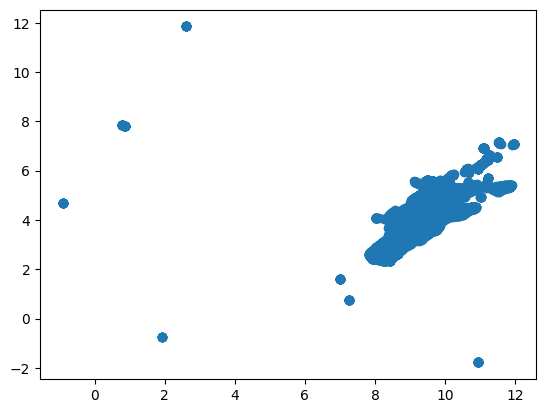

In [16]:
# visualize the results
# plot the first two dimensions
plt.scatter(umap_em[:,0], umap_em[:,1])
plt.show()

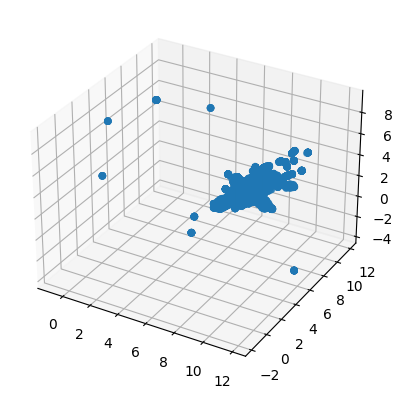

In [17]:
from mpl_toolkits import mplot3d

fig = plt.figure()
ax = plt.axes(projection="3d")
ax.scatter3D(umap_em[:,0], umap_em[:,1], umap_em[:,2])
plt.show()

In [18]:
umap_em[0]

array([9.234968 , 4.5894623, 4.758889 , 6.3276844, 5.4560323, 2.9881814,
       2.3948884, 6.0616856, 6.542284 , 4.321691 , 5.262215 ],
      dtype=float32)

In [19]:
umap_em.shape

(47856, 11)

## HDBSCAN

> HDBSCAN is a density-based clustering algorithm that can discover clusters of varying shapes and sizes. It works by first computing the minimum spanning tree of the data, and then clustering the tree nodes based on their density.

In [ ]:
!pip install hdbscan

In [22]:
import hdbscan

In [23]:
# apply HDBSCAN to the sentence embeddings
hdbscan_obj = hdbscan.HDBSCAN(min_cluster_size=5, 
                              min_samples=1,
                              metric="euclidean",
                              cluster_selection_method="eom")

> In this code, min_cluster_size specifies the minimum number of points needed for a cluster to be formed, min_samples specifies the number of neighboring points needed for a point to be considered a core point, and metric specifies the distance metric used to measure the distance between points.

In [24]:
hdbscan_labels = hdbscan_obj.fit_predict(sentence_embeddings)

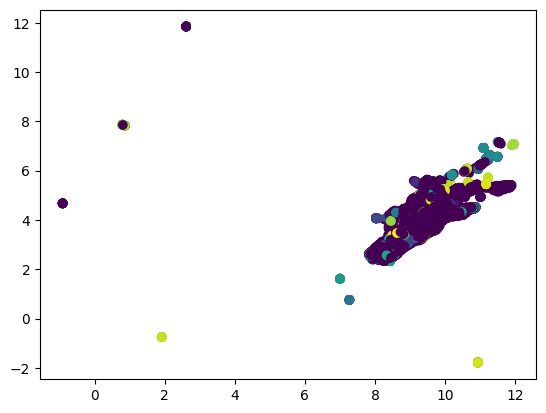

In [25]:
# visualize the results
plt.scatter(umap_em[:,0], umap_em[:,1], c=hdbscan_labels, cmap="viridis")
plt.show()

> Points that are close together in the plot belong to the same cluster, while points that are far away belog to different clusters.

## BERTopic

In [ ]:
!pip install bertopic

In [61]:
# convert the reduced embedding `umap_em` to list of strings to feed it to the BERTopic
# umap_em_strings = [" ".join(map(str, row)) for row in umap_em]

In [20]:
sent = list(df["lemmatized"])

In [32]:
from bertopic import BERTopic

# Create a BERTopic model and fit it to the sentence embeddings
topic_model = BERTopic(language="multilingual", calculate_probabilities=True, verbose=True)
topics, probs = topic_model.fit_transform(sent)

Batches:   0%|          | 0/1496 [00:00<?, ?it/s]

2023-03-31 15:41:23,609 - BERTopic - Transformed documents to Embeddings
2023-03-31 15:42:08,247 - BERTopic - Reduced dimensionality
2023-03-31 15:45:39,587 - BERTopic - Clustered reduced embeddings


In [7]:
from bertopic import BERTopic

model = BERTopic.load("/content/drive/MyDrive/BERTopic+embeddings/bert-model")

In [26]:
freq = model.get_topic_info()
print("Number of topics: {}".format(len(freq)))
freq.head(10)

Number of topics: 290


,Topic,Count,Name
0,-1,24497,-1_product_fijn_wel_app
1,0,1771,0_betaalverzoek_terugbetaling_rekening_betalen
2,1,1157,1_fles_bier_cola_wijn
3,2,1112,2_code_voucher_servicecode_hema
4,3,1065,3_annuleren_bestelling_morgen_order_number
5,4,750,4_post_zegel_spaarzegel_per
6,5,676,5_wachtwoord_nieuw_emailadres_account
7,6,522,6_kaas_beleg_jong_schimmel
8,7,425,7_brood_la_place_broden
9,8,402,8_uur_tussen_morgen_aanpassen


In [39]:
# Select most 3 similar topics
similar_topics, similarity = model.find_topics("betalen", top_n = 3)

In [40]:
most_similar = similar_topics[0]
print("Most Similar Topic Info: \n{}".format(model.get_topic(most_similar)))
print("Similarity Score: {}".format(similarity[0]))

Most Similar Topic Info: 
[('betaalverzoek', 0.013442101648619552), ('terugbetaling', 0.012364555219188186), ('rekening', 0.011485575817659759), ('betalen', 0.010923261461685506), ('binnen', 0.010491990184085453), ('bedrag', 0.01045228347774086), ('werkdag', 0.009905145733082599), ('betaling', 0.009456530326480883), ('ontvangen', 0.008221302558100978), ('goedkeuren', 0.007047868653086867)]
Similarity Score: 0.8831701515126258


In [42]:
from scipy.cluster import hierarchy as sch
# Hierarchical topics
linkage_function = lambda x: sch.linkage(x, "single", optimal_ordering=True)
hierarchical_topics = model.hierarchical_topics(sent, linkage_function=linkage_function)

100%|██████████| 288/288 [00:03<00:00, 80.17it/s]


In [45]:
model.visualize_hierarchy(hierarchical_topics=hierarchical_topics, top_n_topics=40)

In [12]:
model.topic_representations_

{-1: [('product', 0.003157533821237342),
  ('fijn', 0.0031285354179809363),
  ('wel', 0.0030984180309097304),
  ('app', 0.0030837714855191985),
  ('jumbo', 0.0030823557066161425),
  ('gaan', 0.003045330505001123),
  ('chat', 0.003045109091966786),
  ('graag', 0.00303588282340366),
  ('zien', 0.0030250242905102472),
  ('goed', 0.0030240182688106693)],
 0: [('betaalverzoek', 0.013442101648619552),
  ('terugbetaling', 0.012364555219188186),
  ('rekening', 0.011485575817659759),
  ('betalen', 0.010923261461685506),
  ('binnen', 0.010491990184085453),
  ('bedrag', 0.01045228347774086),
  ('werkdag', 0.009905145733082599),
  ('betaling', 0.009456530326480883),
  ('ontvangen', 0.008221302558100978),
  ('goedkeuren', 0.007047868653086867)],
 1: [('fles', 0.035033132311462066),
  ('bier', 0.020036933078923236),
  ('cola', 0.014058717932281358),
  ('wijn', 0.01301167086567149),
  ('statiegeld', 0.012086280681186935),
  ('kratt', 0.010786259720253101),
  ('leeg', 0.010517284074256691),
  ('krat',

In [8]:
model.visualize_barchart()

In [14]:
model.get_topic(2)

[('code', 0.037940346488792194),
 ('voucher', 0.019199596246431288),
 ('servicecode', 0.014507062541698883),
 ('hema', 0.012183806259995064),
 ('blokkeren', 0.01158322458614059),
 ('kortingscode', 0.011455716999079107),
 ('geldig', 0.008985665667964665),
 ('gebruiken', 0.008774461428945227),
 ('korting', 0.007886283916842821),
 ('punt', 0.007234271979592277)]

In [16]:
# get top n topics and their associated keywords
n_topics = 10
topic_keywords = model.get_topic(n_topics)

# print the top keywords for each topic
for topic in topic_keywords:
    print(topic)

('euro', 0.031076810382690348)
('statiegeld', 0.008081632395007556)
('betalen', 0.007849909777607326)
('bedrag', 0.007825387505892723)
('rekening', 0.005931804479952235)
('inleveren', 0.00458115670263004)
('korting', 0.004547959673160619)
('order_number', 0.004453538745498996)
('punt', 0.004193709908641232)
('ontvangen', 0.004144723650239106)


In [16]:
# @title Save the results

import pickle

# save the embeddings to a file
with open("bertopic-results.pickle", "wb") as handle:
    pickle.dump((topics, probs), handle, protocol=pickle.HIGHEST_PROTOCOL)

In [17]:
freq = model.get_topic_info()
freq.head()

,Topic,Count,Name
0,-1,24497,-1_product_fijn_wel_app
1,0,1771,0_betaalverzoek_terugbetaling_rekening_betalen
2,1,1157,1_fles_bier_cola_wijn
3,2,1112,2_code_voucher_servicecode_hema
4,3,1065,3_annuleren_bestelling_morgen_order_number


In [22]:
model.get_document_info(sent).head(10)

,Document,Topic,Name,Top_n_words,Probability,Representative_document
0,dag probleem bestelling melden ontvang vandaag...,-1,-1_product_fijn_wel_app,product - fijn - wel - app - jumbo - gaan - ch...,0.014032,False
1,goed heer mevrouw inmiddels maand ver steeds r...,50,50_auto_autos_max_verstapp,auto - autos - max - verstapp - raceauto - rac...,0.346172,False
2,staan voedingswaarden vermelden fles wijn verk...,1,1_fles_bier_cola_wijn,fles - bier - cola - wijn - statiegeld - kratt...,0.174091,False
3,bestelling [ORDER_NUMBER] servicecode invullen...,-1,-1_product_fijn_wel_app,product - fijn - wel - app - jumbo - gaan - ch...,0.710364,False
4,hi bestelling net ontvangen fles inleveren gro...,1,1_fles_bier_cola_wijn,fles - bier - cola - wijn - statiegeld - kratt...,0.244116,False
5,possible conversation english made refund requ...,11,11_delivery_order_thank_nice,delivery - order - thank - nice - day - number...,0.204596,False
6,even geven morgen dubbel betaling verleden wee...,-1,-1_product_fijn_wel_app,product - fijn - wel - app - jumbo - gaan - ch...,0.256061,False
7,jumbo proberen artikel bestelling toe voegen a...,-1,-1_product_fijn_wel_app,product - fijn - wel - app - jumbo - gaan - ch...,0.132586,False
8,goedenmiddag repen verkade bestellen leverbaar...,-1,-1_product_fijn_wel_app,product - fijn - wel - app - jumbo - gaan - ch...,0.093200,False
9,best jumbo terug betaling ontvangen sinds laat...,0,0_betaalverzoek_terugbetaling_rekening_betalen,betaalverzoek - terugbetaling - rekening - bet...,1.000000,False


In [23]:
model.visualize_topics()

In [78]:
topic_model.save("bert-model")

In [79]:
model = BERTopic.load("/content/drive/MyDrive/BERTopic+embeddings/bert-model")

In [82]:
new_text = "probleem bestelling"
topic, confidence = model.transform([new_text])
print(f"Predicted topic: {topic[0]}, Confidence: {confidence[0]}")

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

2023-03-29 15:26:54,021 - BERTopic - Reduced dimensionality
2023-03-29 15:26:54,086 - BERTopic - Calculated probabilities with HDBSCAN
2023-03-29 15:26:54,088 - BERTopic - Predicted clusters


Predicted topic: 186, Confidence: [0.00198894 0.00135463 0.00112529 0.00497318 0.00463817 0.00145334
 0.0005542  0.00125175 0.00481897 0.00089362 0.00134827 0.00059458
 0.00080951 0.00125475 0.00139853 0.00158178 0.00162505 0.00129647
 0.00090533 0.00057617 0.00368242 0.00187172 0.00095068 0.0011996
 0.00161278 0.0006233  0.00130582 0.00124457 0.00129315 0.00133475
 0.00160423 0.00048579 0.00050489 0.00070945 0.00119984 0.00063369
 0.00183876 0.00061887 0.00116505 0.00321818 0.00118145 0.00119499
 0.00120322 0.00150718 0.00161854 0.00111684 0.00118705 0.00162707
 0.00269264 0.00160939 0.00115244 0.00115304 0.00155797 0.00172872
 0.00115427 0.00269808 0.00227433 0.00434362 0.00048454 0.00219629
 0.00111024 0.00111292 0.00172897 0.00154893 0.00171721 0.00087849
 0.000955   0.00177968 0.00551792 0.0011406  0.00160279 0.00128646
 0.00127169 0.00271065 0.00128818 0.00294059 0.00213076 0.00184384
 0.00099387 0.0006471  0.00173914 0.00118437 0.00116717 0.00101641
 0.00229636 0.0007695  0.0013